<a href="https://colab.research.google.com/github/YashK07/EXL-EQ-2023-Winning-Solution/blob/master/Solution_Code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Importing important libraries**

In [ ]:
import darts
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.graphics.tsaplots import plot_acf
import darts
from sklearn.metrics import mean_absolute_percentage_error, mean_absolute_error, mean_squared_error
from darts import TimeSeries
from darts.models import (
    NaiveSeasonal,
    NaiveDrift,
    Prophet,
    ExponentialSmoothing,
    ARIMA,
    AutoARIMA,
    RegressionEnsembleModel,
    RegressionModel,
    Theta,
    FFT,
    LinearRegressionModel,
    XGBModel,
    CatBoostModel,
    LightGBMModel,
    RandomForest,
    RNNModel
)
from statsmodels.tsa.holtwinters import ExponentialSmoothing as ES
from statsmodels.tsa.holtwinters import SimpleExpSmoothing
from xgboost import XGBRegressor

In [ ]:
data = pd.read_csv('EXL_EQ_2023_Dataset.csv',parse_dates=['Time Periods'], index_col='Time Periods')

In [ ]:
data

,PM2.5,NO,NO2,NOx,NH3,SO2,CO,Ozone,Benzene,Toluene,...,Number of Factories as of 2020 (Units),Installed Capacity of Power as of 2022(Megawatt),Death Rate as of 2020(Per 1000),CNG ONLY,DIESEL,DIESEL/HYBRID,ELECTRIC(BOV),PETROL,PETROL/CNG,PETROL/HYBRID
Time Periods,,,,,,,,,,,,,,,,,,,,,
2020-01-01 00:00:00,549.256878,181.010975,91.247522,188.364425,79.707417,10.175812,3.520142,23.411029,NaN,NaN,...,3259,7617,3.6,"13,968","10,528",32,"12,379","3,60,440","21,424","5,313"
2020-01-01 04:00:00,435.438303,194.247049,79.661701,203.481853,66.258913,11.615925,3.464807,29.331609,9.827428,NaN,...,3259,7617,3.6,"13,968","10,528",32,"12,379","3,60,440","21,424","5,313"
2020-01-01 08:00:00,453.312378,112.499494,121.740909,153.914993,74.356791,10.590183,2.460498,30.172308,9.085975,NaN,...,3259,7617,3.6,"13,968","10,528",32,"12,379","3,60,440","21,424","5,313"
2020-01-01 12:00:00,186.603123,56.922094,114.142207,91.504524,NaN,12.217971,1.405930,30.493537,3.884649,104.475114,...,3259,7617,3.6,"13,968","10,528",32,"12,379","3,60,440","21,424","5,313"
2020-01-01 16:00:00,262.616309,77.363086,123.790340,117.065760,NaN,13.331616,2.692100,18.045684,5.605006,96.718827,...,3259,7617,3.6,"13,968","10,528",32,"12,379","3,60,440","21,424","5,313"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 04:00:00,196.989121,60.688939,88.463906,104.906711,109.511292,53.108086,2.336561,55.699203,3.684526,7.927572,...,25610,43446,5.5,"48,888","2,96,334",155,"1,36,039","17,41,675","1,09,369","22,206"
2022-12-31 08:00:00,187.428487,56.707438,93.311216,103.099160,106.682026,55.535340,2.235001,73.030945,3.388236,6.980251,...,25610,43446,5.5,"48,888","2,96,334",155,"1,36,039","17,41,675","1,09,369","22,206"
2022-12-31 12:00:00,176.635690,28.382382,87.318776,80.058537,110.258415,53.701056,1.754315,93.830288,3.328736,6.993954,...,25610,43446,5.5,"48,888","2,96,334",155,"1,36,039","17,41,675","1,09,369","22,206"


# Data Preprocessing

In [ ]:
data.drop(['CH4','VWS'],axis=1,inplace=True) #high percentage of null values

Categorical encoding, null value imputation and removing stationarity.

In [ ]:
cat = [i for i in data.columns if data[i].dtype=="object"]
cat

['City',
 'State',
 'CNG ONLY',
 'DIESEL',
 'ELECTRIC(BOV)',
 'PETROL',
 'PETROL/CNG',
 'PETROL/HYBRID']

In [ ]:
# define the function to be applied
def my_func(df):
    print()
    df = df.str.replace(',','')
    #df = df.apply(lambda x : x.replace(",",""))
    #print(df)
    df = df.astype(int)
    return df
    #print(df)

In [ ]:
l = ['DIESEL',
 'ELECTRIC(BOV)',
 'PETROL',
 'PETROL/CNG',
 'PETROL/HYBRID']

for i in l:
    data[i] = my_func(data[i])

In [ ]:
data['CNG ONLY'] = data['CNG ONLY'].str.replace(',', '')

# Convert to integer
data['CNG ONLY'] = pd.to_numeric(data['CNG ONLY'], errors='coerce').astype('Int64')

In [ ]:
data[data['CNG ONLY'].isnull()==True]

,PM2.5,NO,NO2,NOx,NH3,SO2,CO,Ozone,Benzene,Toluene,...,Number of Factories as of 2020 (Units),Installed Capacity of Power as of 2022(Megawatt),Death Rate as of 2020(Per 1000),CNG ONLY,DIESEL,DIESEL/HYBRID,ELECTRIC(BOV),PETROL,PETROL/CNG,PETROL/HYBRID
Time Periods,,,,,,,,,,,,,,,,,,,,,
2020-01-01 00:00:00,25.516342,4.612896,6.876664,11.748235,13.053931,39.705023,0.219372,27.734092,0.309093,NaN,...,204,278,4.0,<NA>,2047,11,104,13481,2,85
2020-01-01 04:00:00,25.516342,4.612896,6.876664,11.748235,13.053931,39.705023,0.219372,27.734092,0.309093,NaN,...,204,278,4.0,<NA>,2047,11,104,13481,2,85
2020-01-01 08:00:00,25.516342,4.612896,6.876664,11.748235,13.053931,39.705023,0.219372,27.734092,0.309093,NaN,...,204,278,4.0,<NA>,2047,11,104,13481,2,85
2020-01-01 12:00:00,25.516342,4.612896,6.876664,11.748235,13.053931,39.705023,0.219372,27.734092,0.309093,NaN,...,204,278,4.0,<NA>,2047,11,104,13481,2,85
2020-01-01 16:00:00,25.516342,4.612896,6.876664,11.748235,13.053931,39.705023,0.219372,27.734092,0.309093,NaN,...,204,278,4.0,<NA>,2047,11,104,13481,2,85
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 04:00:00,12.110000,1.450000,43.170000,44.620000,114.110000,8.000000,0.300000,8.000000,3.420000,5.12,...,1022,3510,4.6,<NA>,23671,2,4688,132869,3,1575
2022-12-31 08:00:00,12.060000,1.670000,45.260000,46.930000,119.970000,8.000000,0.310000,8.000000,3.420000,3.11,...,1022,3510,4.6,<NA>,23671,2,4688,132869,3,1575
2022-12-31 12:00:00,12.060000,1.670000,45.260000,46.930000,119.970000,8.000000,0.310000,8.000000,3.420000,3.11,...,1022,3510,4.6,<NA>,23671,2,4688,132869,3,1575


Initial data preprocessing is done.

Lets drop the null values from the target column and the corresponding row from the data.

In [ ]:
data = data.dropna(subset=['PM2.5'])

In [ ]:
data

,PM2.5,NO,NO2,NOx,NH3,SO2,CO,Ozone,Benzene,Toluene,...,Number of Factories as of 2020 (Units),Installed Capacity of Power as of 2022(Megawatt),Death Rate as of 2020(Per 1000),CNG ONLY,DIESEL,DIESEL/HYBRID,ELECTRIC(BOV),PETROL,PETROL/CNG,PETROL/HYBRID
Time Periods,,,,,,,,,,,,,,,,,,,,,
2020-01-01 00:00:00,549.256878,181.010975,91.247522,188.364425,79.707417,10.175812,3.520142,23.411029,NaN,NaN,...,3259,7617,3.6,13968,10528,32,12379,360440,21424,5313
2020-01-01 04:00:00,435.438303,194.247049,79.661701,203.481853,66.258913,11.615925,3.464807,29.331609,9.827428,NaN,...,3259,7617,3.6,13968,10528,32,12379,360440,21424,5313
2020-01-01 08:00:00,453.312378,112.499494,121.740909,153.914993,74.356791,10.590183,2.460498,30.172308,9.085975,NaN,...,3259,7617,3.6,13968,10528,32,12379,360440,21424,5313
2020-01-01 12:00:00,186.603123,56.922094,114.142207,91.504524,NaN,12.217971,1.405930,30.493537,3.884649,104.475114,...,3259,7617,3.6,13968,10528,32,12379,360440,21424,5313
2020-01-01 16:00:00,262.616309,77.363086,123.790340,117.065760,NaN,13.331616,2.692100,18.045684,5.605006,96.718827,...,3259,7617,3.6,13968,10528,32,12379,360440,21424,5313
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 04:00:00,196.989121,60.688939,88.463906,104.906711,109.511292,53.108086,2.336561,55.699203,3.684526,7.927572,...,25610,43446,5.5,48888,296334,155,136039,1741675,109369,22206
2022-12-31 08:00:00,187.428487,56.707438,93.311216,103.099160,106.682026,55.535340,2.235001,73.030945,3.388236,6.980251,...,25610,43446,5.5,48888,296334,155,136039,1741675,109369,22206
2022-12-31 12:00:00,176.635690,28.382382,87.318776,80.058537,110.258415,53.701056,1.754315,93.830288,3.328736,6.993954,...,25610,43446,5.5,48888,296334,155,136039,1741675,109369,22206


# Null value imputation

In [ ]:
data['NO'].isnull()

Time Periods
2020-01-01 00:00:00    False
2020-01-01 04:00:00    False
2020-01-01 08:00:00    False
2020-01-01 12:00:00    False
2020-01-01 16:00:00    False
                       ...  
2022-12-31 04:00:00    False
2022-12-31 08:00:00    False
2022-12-31 12:00:00    False
2022-12-31 16:00:00    False
2022-12-31 20:00:00    False
Name: NO, Length: 218044, dtype: bool

In [ ]:
interpolate = [i for i in data.columns if data[i].isnull().sum()>0]
interpolate

['NO',
 'NO2',
 'NOx',
 'NH3',
 'SO2',
 'CO',
 'Ozone',
 'Benzene',
 'Toluene',
 'Temp',
 'RH',
 'WS',
 'WD',
 'SR',
 'BP',
 'AT',
 'RF',
 'Eth-Benzene',
 'Xylene',
 'MP-Xylene',
 'O Xylene',
 'CNG ONLY']

In [ ]:
for i in interpolate:
    print(i, (data[i].isnull().sum()/218044)*100)

NO 1.1052815028159455
NO2 1.2465373961218837
NOx 1.3685311221588303
NH3 1.3974243730623177
SO2 0.634734273816294
CO 0.753059015611528
Ozone 0.8191007319623562
Benzene 1.797802278439214
Toluene 24.745464218231184
Temp 76.94502027113793
RH 11.098677331180863
WS 1.7945919172277156
WD 1.410265817908312
SR 6.184072939406725
BP 28.22870613270716
AT 8.904624754636679
RF 1.7748711269285098
Eth-Benzene 19.113573407202217
Xylene 38.24778485076406
MP-Xylene 21.460806075837905
O Xylene 44.39470932472345
CNG ONLY 6.031810093375649


<Axes: ylabel='Time Periods'>

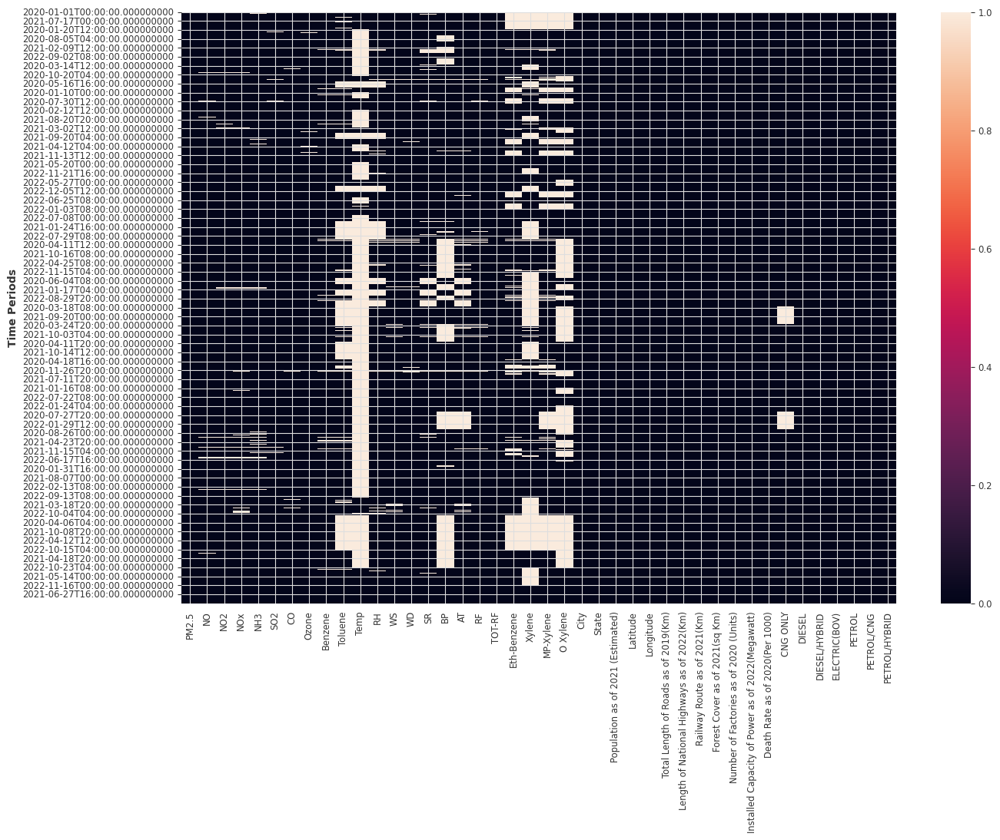

In [ ]:
plt.figure(figsize=(15,10))
sns.heatmap(data.isnull())

In [ ]:
#interpolate using time interpolation, which is same as the linear interpolation for equally space time series data
for col in interpolate:
    if(col!="CNG ONLY"):
        data[col] = data[col].interpolate(method = "time")

<Axes: ylabel='Time Periods'>

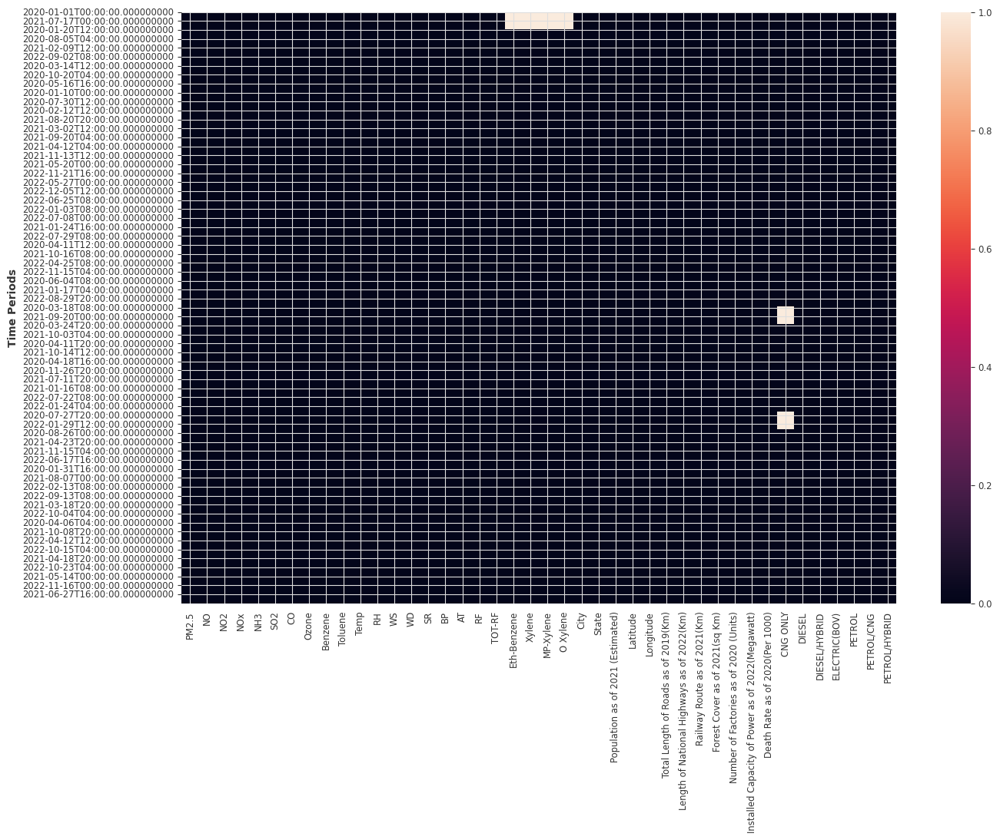

In [ ]:
plt.figure(figsize=(15,10))
sns.heatmap(data.isnull())

In [ ]:
data['CNG ONLY'] = data['CNG ONLY'].interpolate(method = "ffill")

In [ ]:
data['TOT-RF'] = data['TOT-RF'].interpolate(method = "linear",limit_direction='backward')
data['Eth-Benzene'] = data['Eth-Benzene'].interpolate(method = "linear",limit_direction='backward')
data['Xylene'] = data['Xylene'].interpolate(method = "linear",limit_direction='backward')
data['O Xylene'] = data['O Xylene'].interpolate(method = "linear",limit_direction='backward')
data['MP-Xylene'] = data['MP-Xylene'].interpolate(method = "linear",limit_direction='backward')
data['Benzene'] = data['Benzene'].interpolate(method = "linear",limit_direction='backward')
data['Toluene'] = data['Toluene'].interpolate(method = "linear",limit_direction='backward')

<Axes: ylabel='Time Periods'>

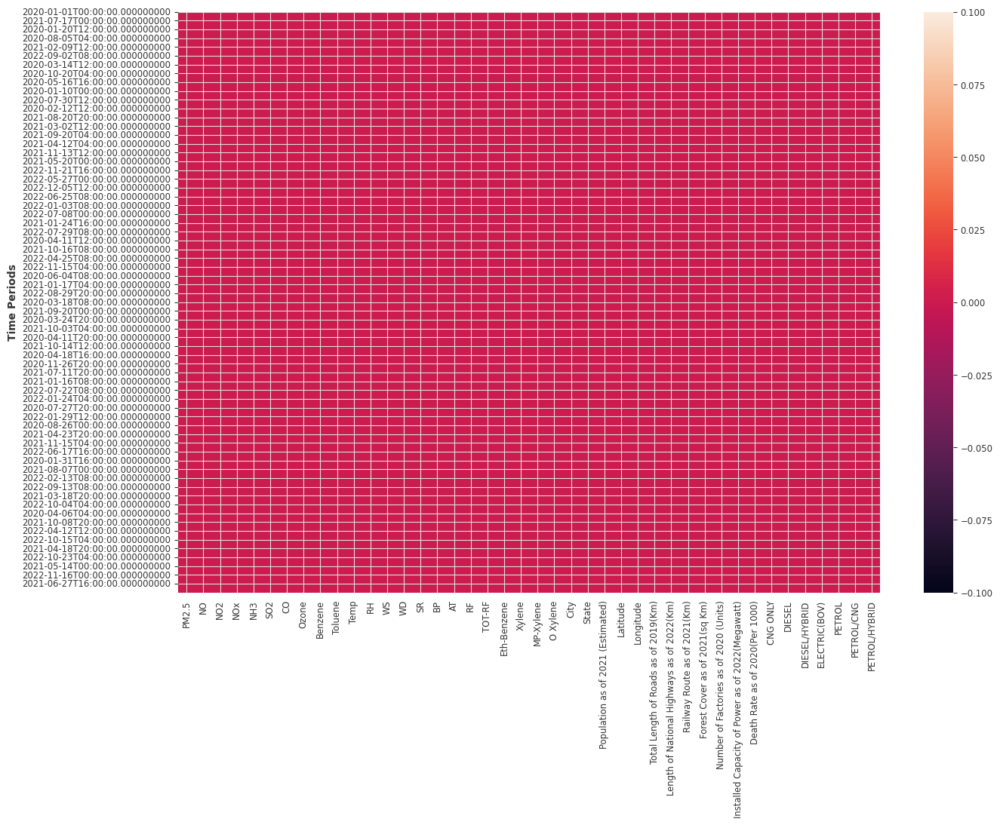

In [ ]:
plt.figure(figsize=(15,10))
sns.heatmap(data.isnull())

In [ ]:
data.isnull().sum()

PM2.5                                               0
NO                                                  0
NO2                                                 0
NOx                                                 0
NH3                                                 0
SO2                                                 0
CO                                                  0
Ozone                                               0
Benzene                                             0
Toluene                                             0
Temp                                                0
RH                                                  0
WS                                                  0
WD                                                  0
SR                                                  0
BP                                                  0
AT                                                  0
RF                                                  0
TOT-RF                      

First **85%** of whole data of individual cities taken for **training** and the rest **15%** for **validation**.

# Exploratory Data Analysis

**Findings:**

In [ ]:
city_dic = {}
for i in data['City'].unique():
    dx = data[data['City']==i]
    city_dic[i] = dx

In [ ]:
city_dic.keys()

dict_keys(['Delhi', 'Ahmedabad', 'Gandhinagar', 'Lucknow', 'Varanasi', 'Meerut', 'Prayagraj', 'Ghaziabad', 'Agra', 'Noida', 'Kanpur', 'Moradabad', 'Guwahati', 'Faridabad', 'Gurugram', 'Jaipur', 'Kota', 'Imphal', 'Thiruvananthapuram', 'Agartala', 'Gaya', 'Muzaffarpur', 'Patna', 'Srinagar', 'Howrah', 'Kolkata', 'Bhopal', 'Gwalior', 'Bengaluru', 'Raipur', 'Bhilai', 'Chandigarh', 'Chennai', 'Mumbai'])

In [ ]:
c_d = city_dic.copy()

In [ ]:
viz_l = [i for i in data.columns if data[i].dtype!='object']

In [ ]:
len(viz_l)

40

In [ ]:
for i in data['City'].unique():
    print(i)

Delhi
Ahmedabad
Gandhinagar
Lucknow
Varanasi
Meerut
Prayagraj
Ghaziabad
Agra
Noida
Kanpur
Moradabad
Guwahati
Faridabad
Gurugram
Jaipur
Kota
Imphal
Thiruvananthapuram
Agartala
Gaya
Muzaffarpur
Patna
Srinagar
Howrah
Kolkata
Bhopal
Gwalior
Bengaluru
Raipur
Bhilai
Chandigarh
Chennai
Mumbai


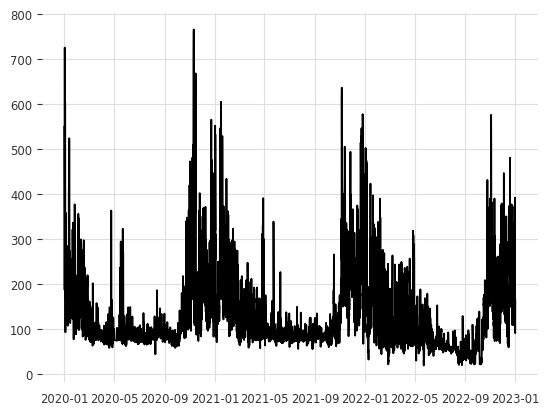

In [ ]:
plt.plot(city_dic['Delhi']['PM2.5']) #lets check a sample PM2.5

In [ ]:
def plot_seasonality(data):
    #check for data stationarity in pm2.5 concentration levels -
    rolling_mean = data.rolling(window=12).mean()
    rolling_std = data.rolling(window=12).std()

    plt.figure(figsize=(25,10))
    plt.plot(data, label='Original')
    plt.plot(rolling_mean, label='Rolling Mean')
    plt.plot(rolling_std, label='Rolling Std')
    plt.legend(loc='best')
    plt.show()

**Seasonality Plot**

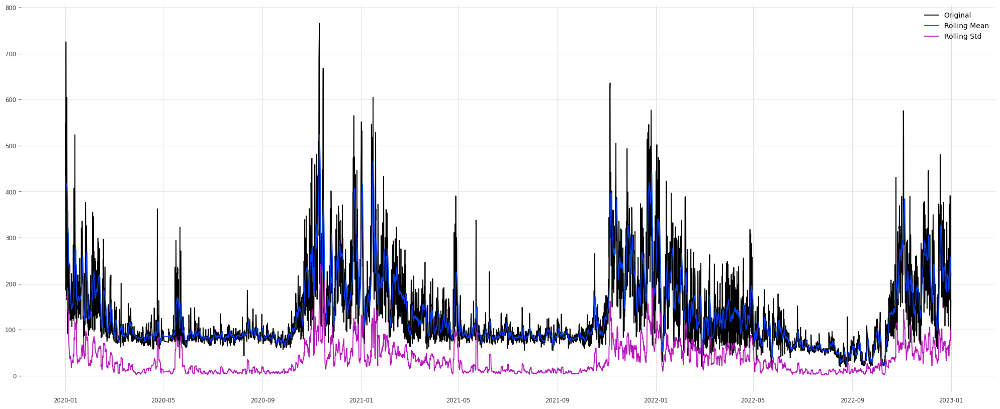

In [ ]:
plot_seasonality(city_dic['Delhi']['PM2.5'])

- NO 1.1052815028159455
- NO2 1.2465373961218837
- NOx 1.3685311221588303
- NH3 1.3974243730623177
- SO2 0.634734273816294
- CO 0.753059015611528
- Ozone 0.8191007319623562
- Benzene 1.797802278439214
- Toluene 24.745464218231184
- Temp 76.94502027113793
- RH 11.098677331180863
- WS 1.7945919172277156
- WD 1.410265817908312
- SR 6.184072939406725
- BP 28.22870613270716
- AT 8.904624754636679
- RF 1.7748711269285098
- Eth-Benzene 19.113573407202217
- Xylene 38.24778485076406
- MP-Xylene 21.460806075837905
- O Xylene 44.39470932472345
- CNG ONLY 6.031810093375649

**All Attributes Visualization**

Delhi


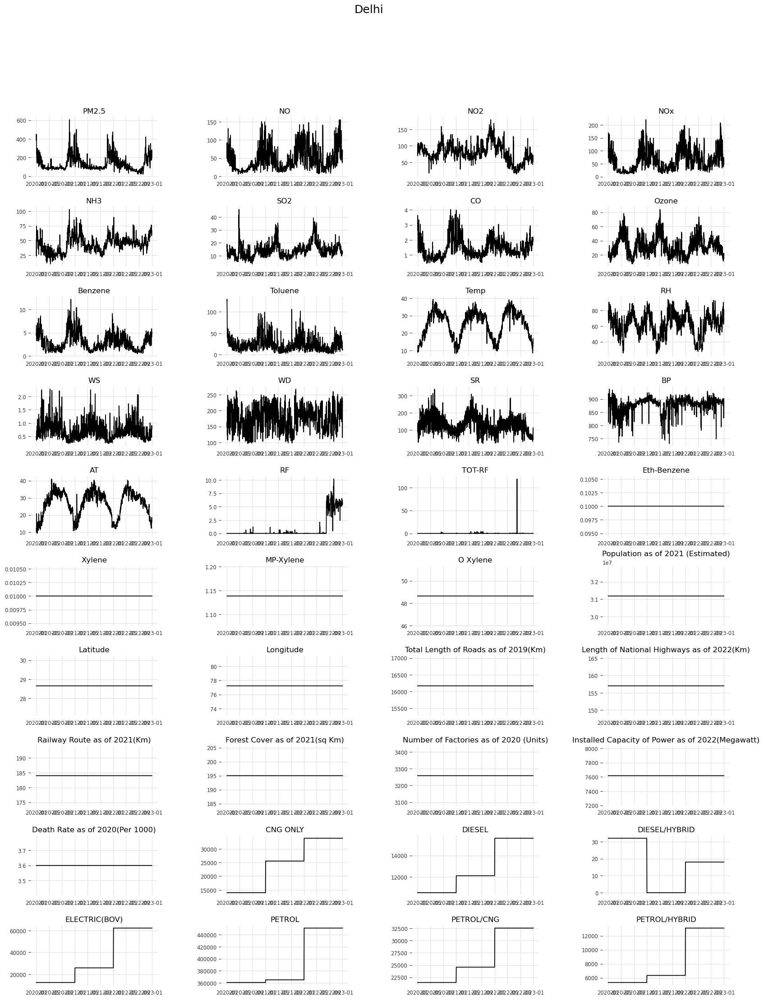

Ahmedabad


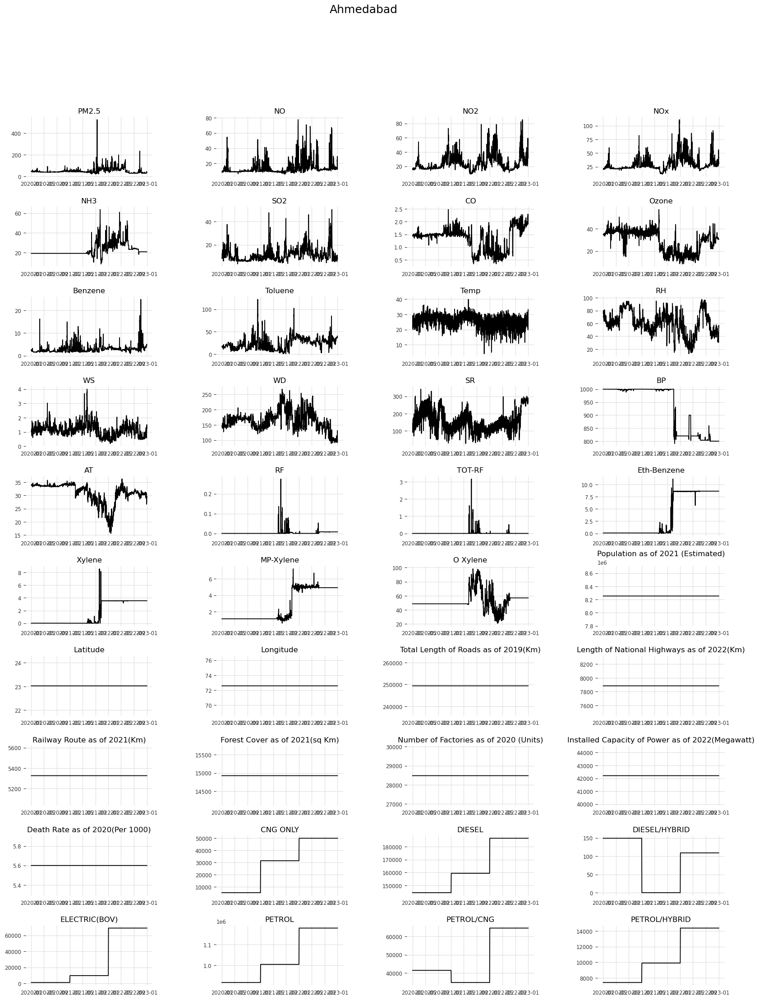

Gandhinagar


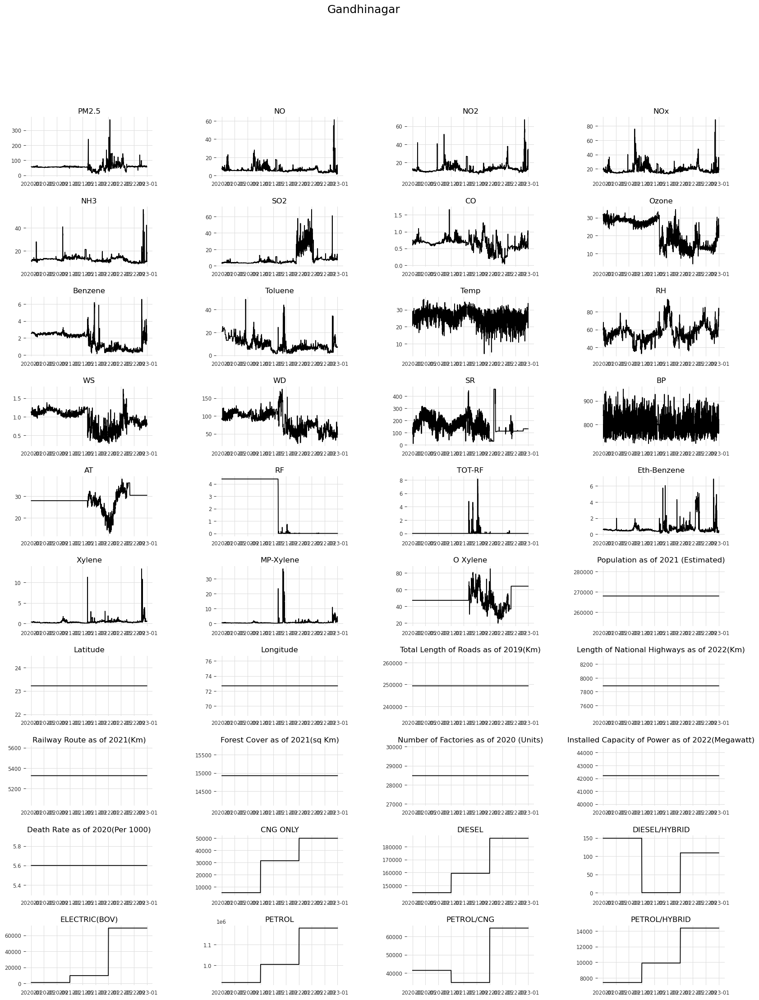

Lucknow


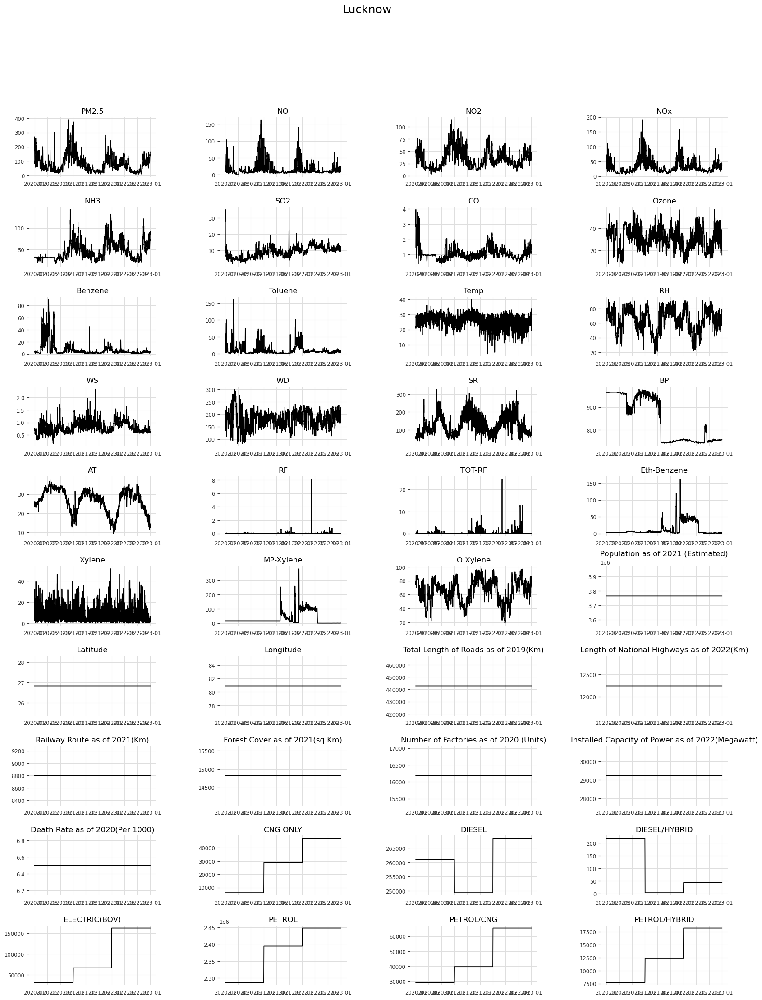

Varanasi


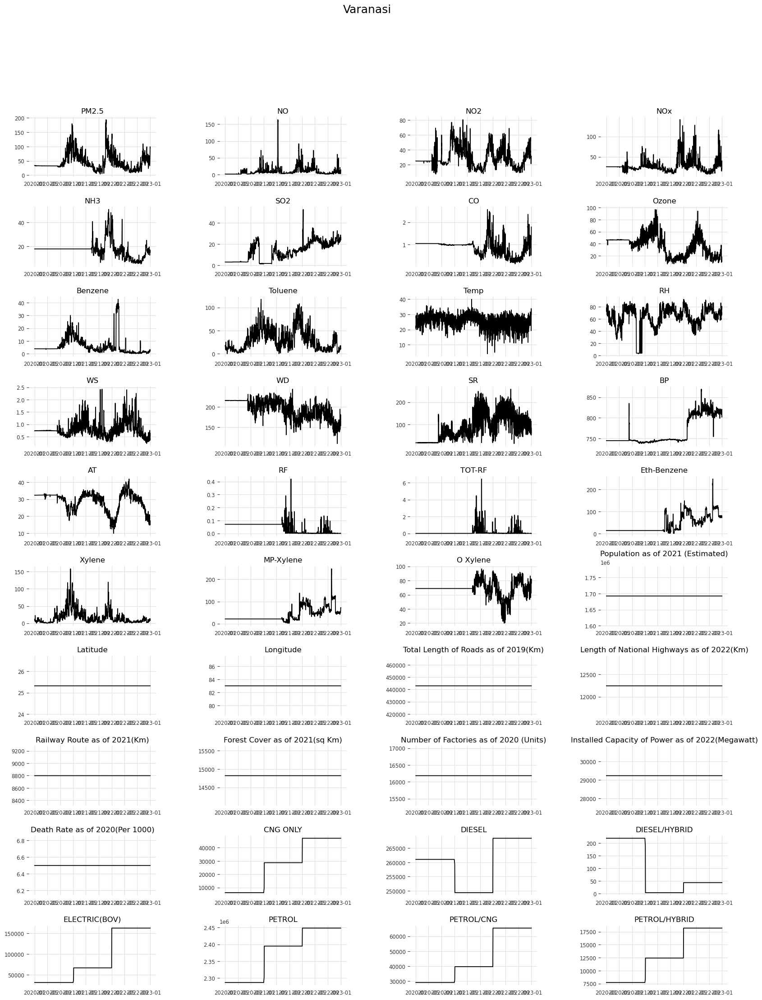

Meerut


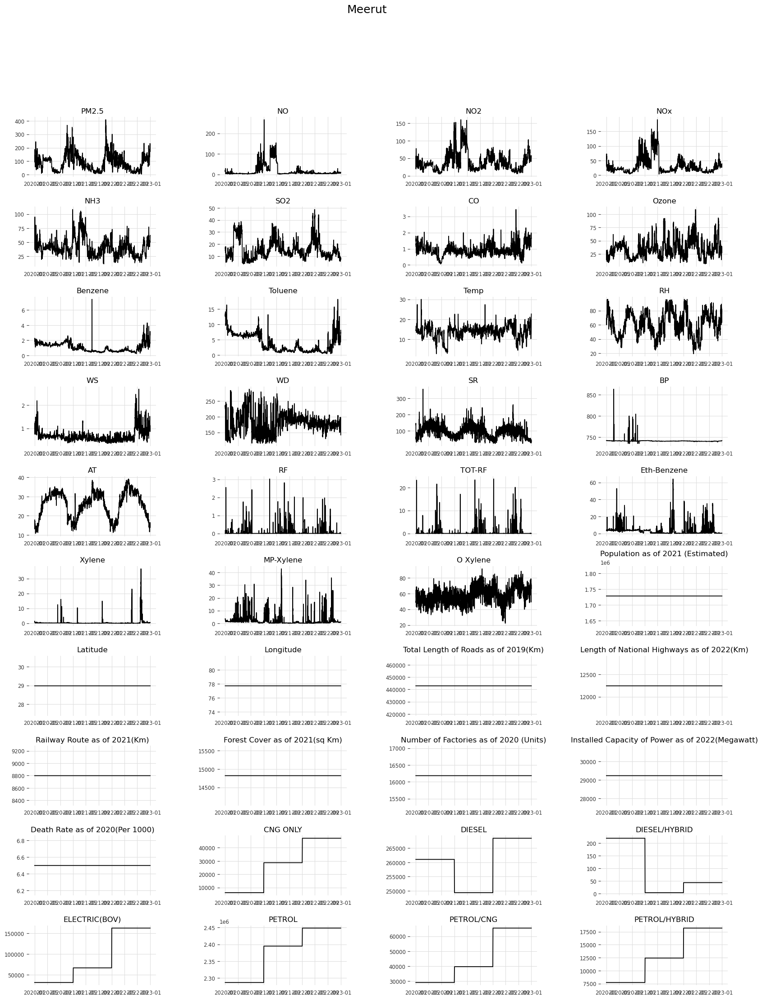

Prayagraj


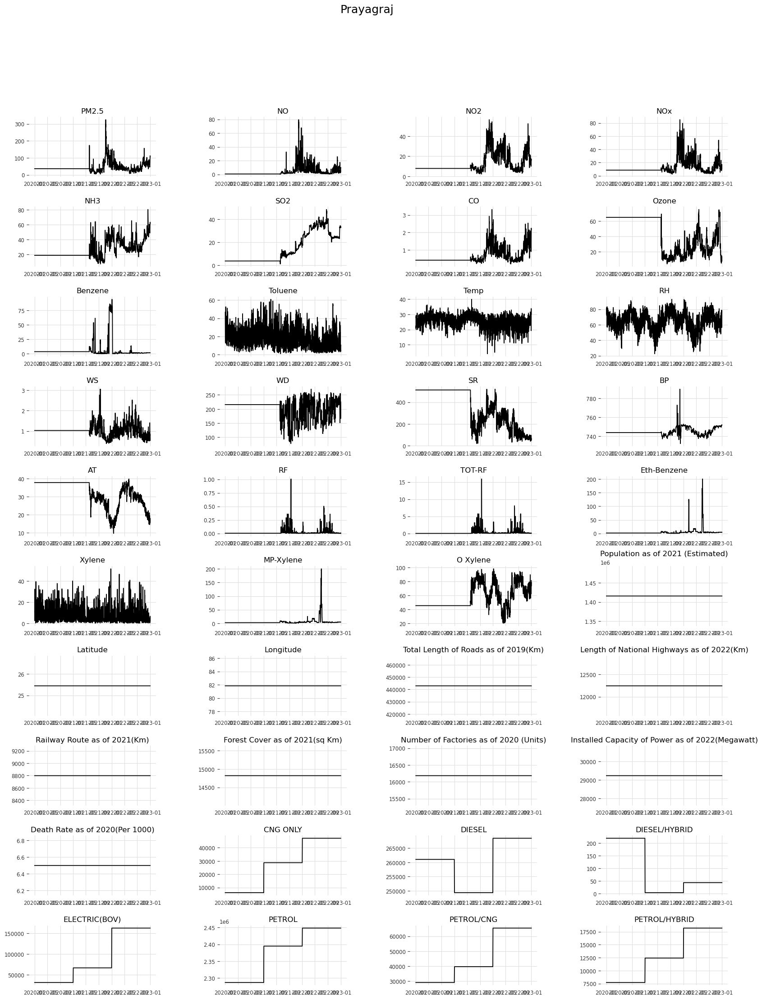

Ghaziabad


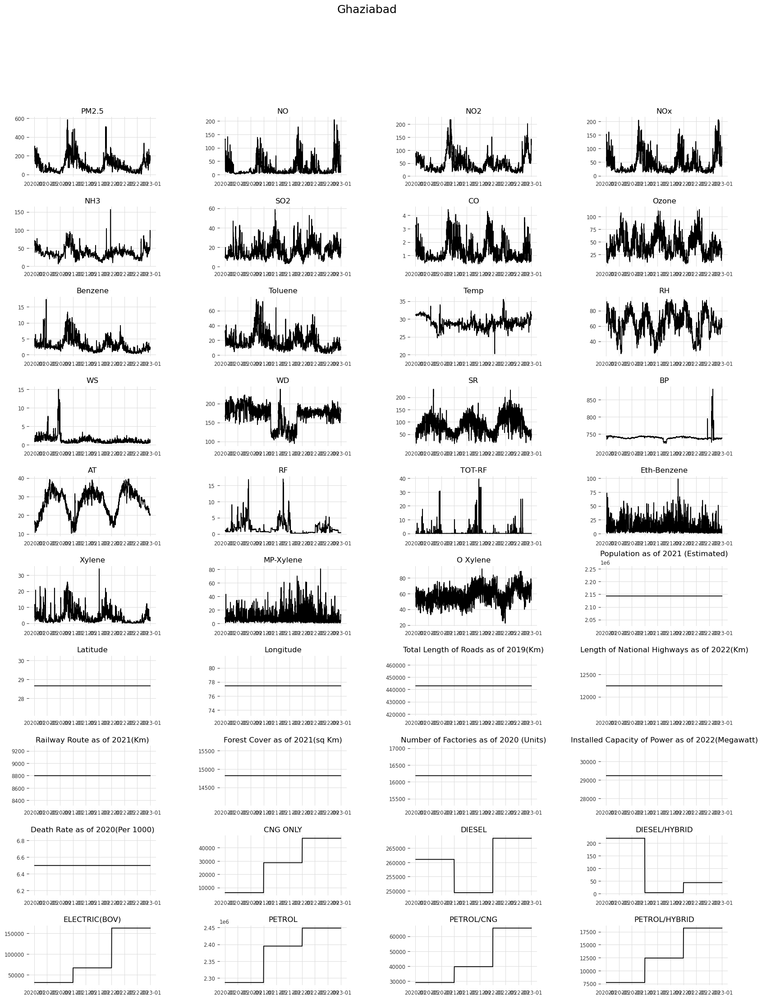

Agra


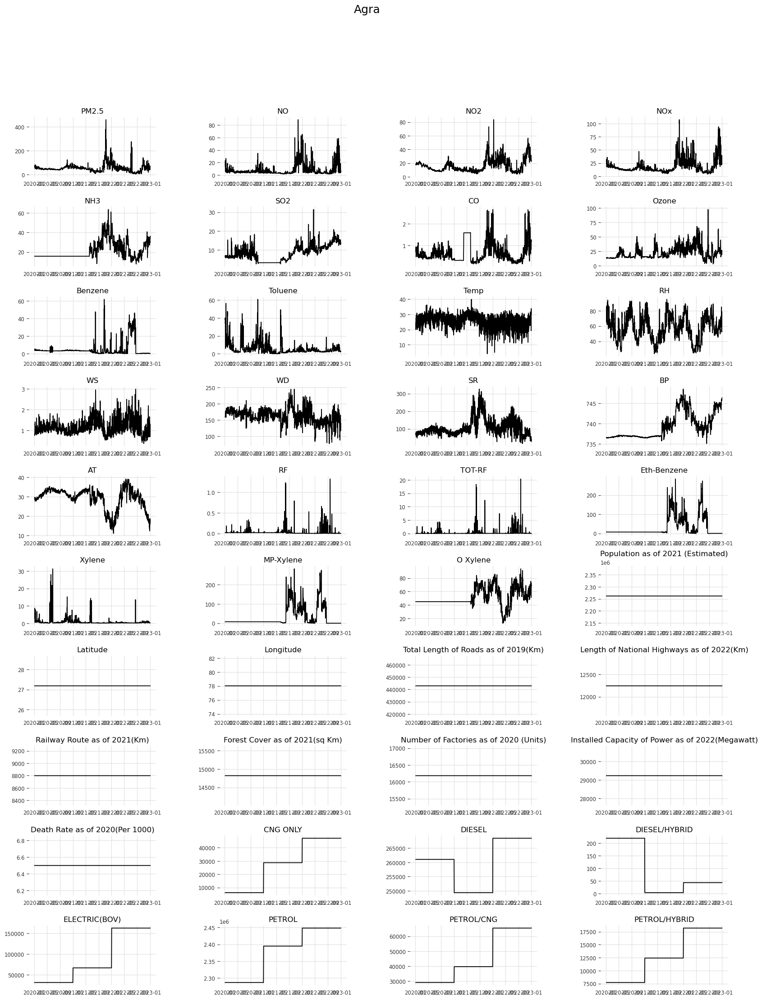

Noida


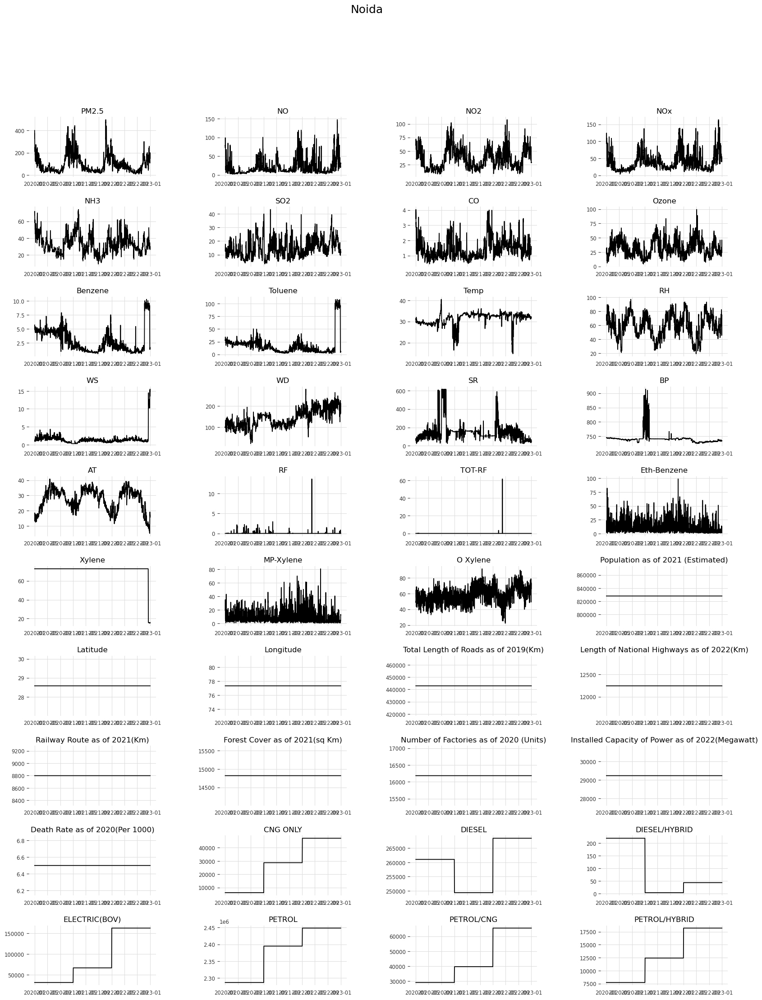

Kanpur


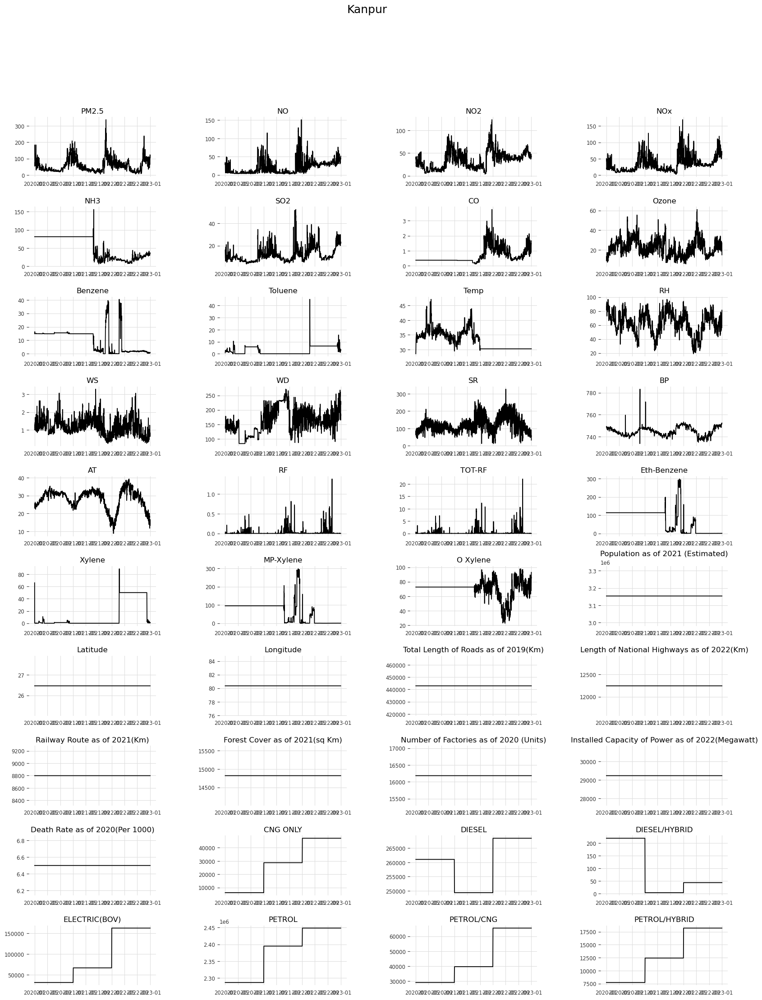

Moradabad


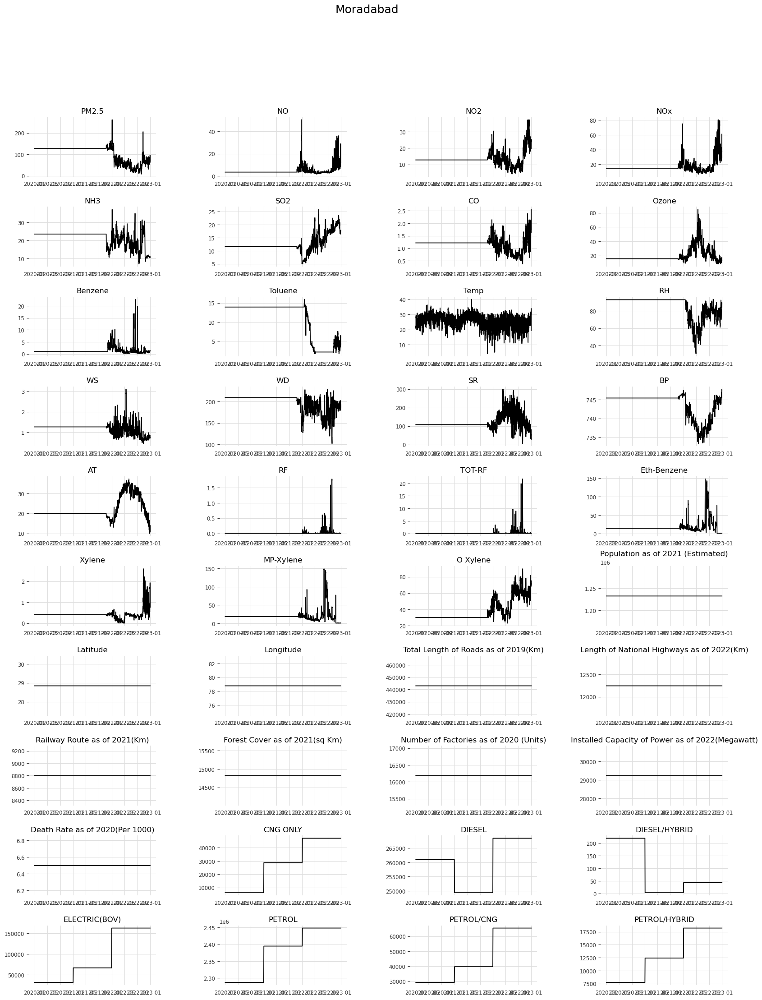

Guwahati


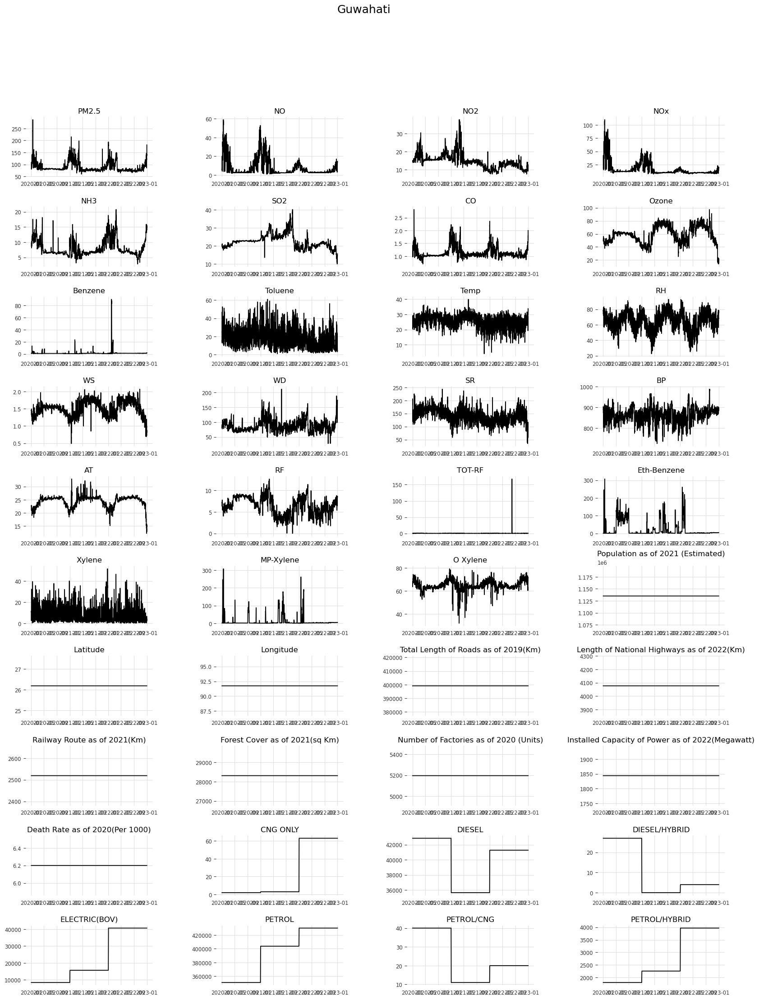

Faridabad


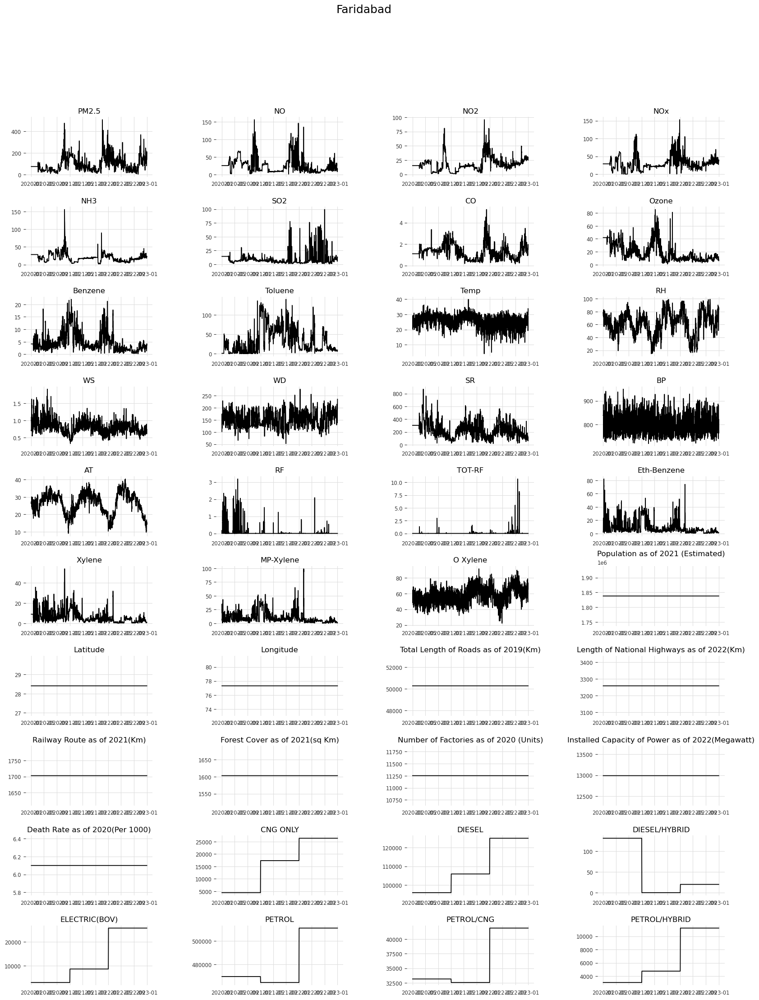

Gurugram


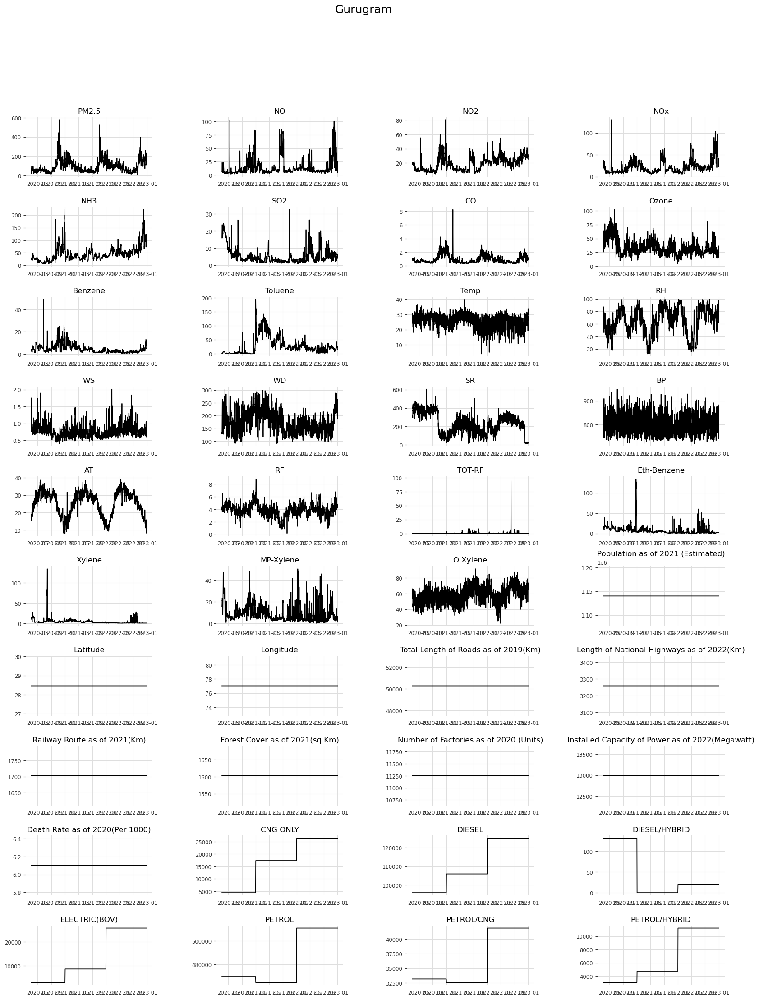

Jaipur


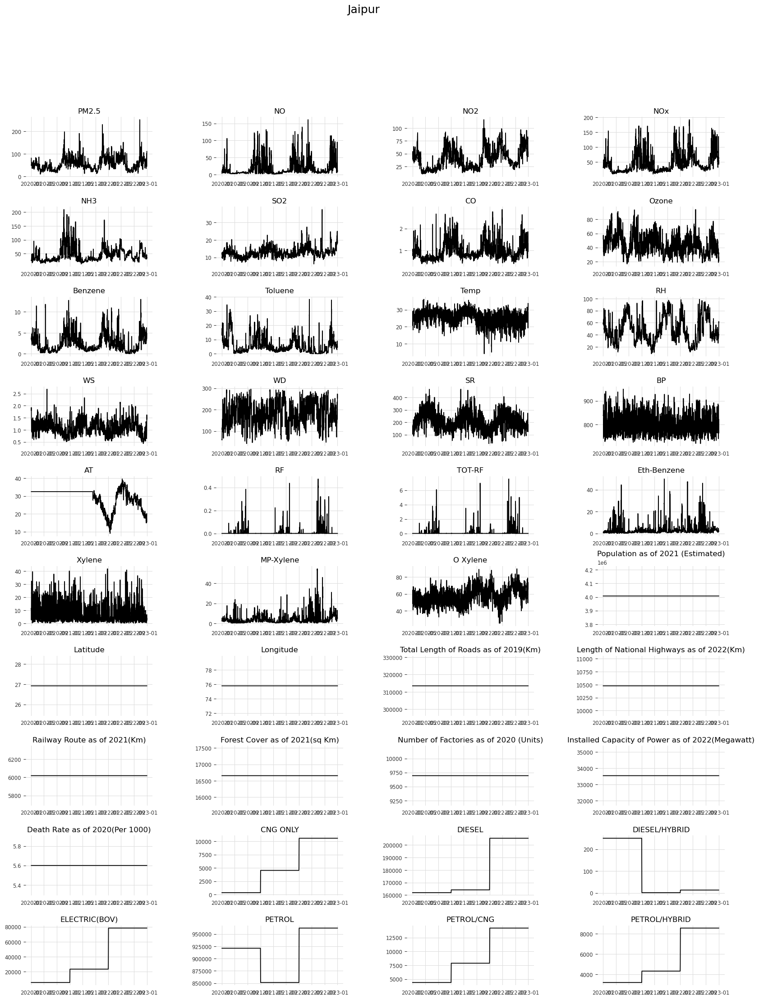

Kota


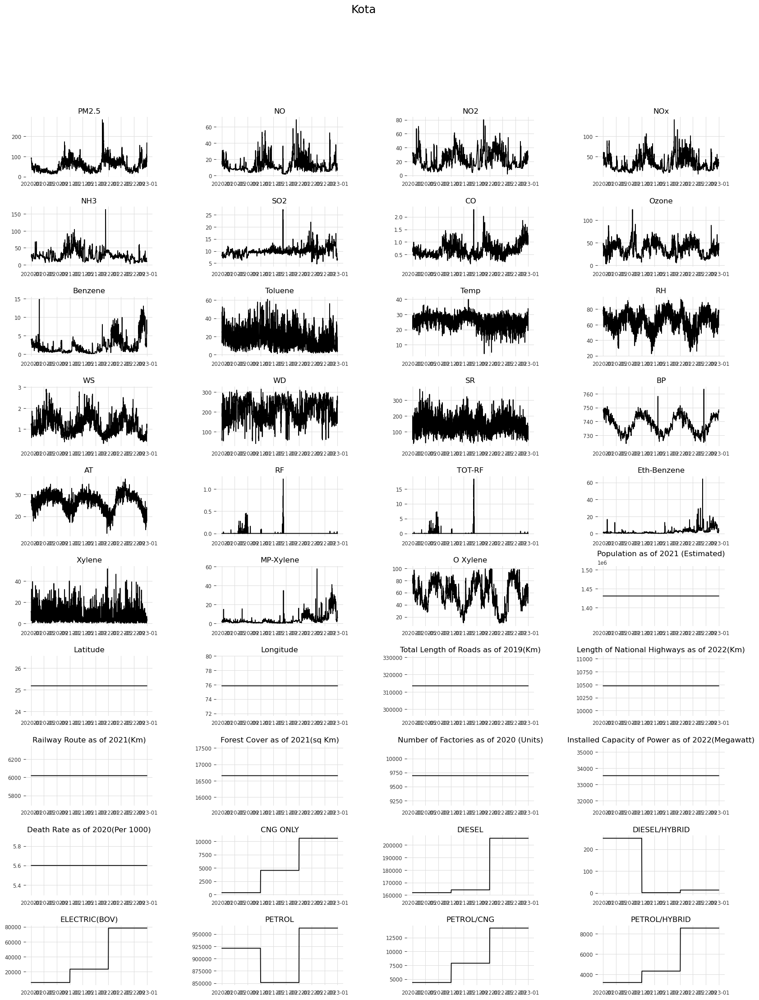

Imphal


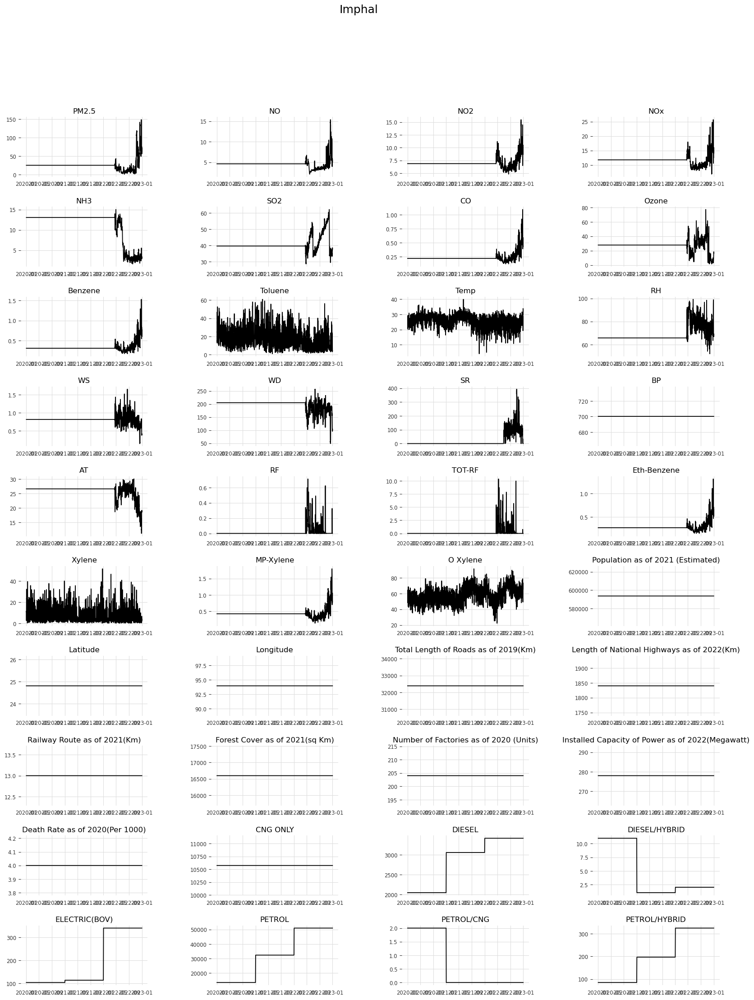

Thiruvananthapuram


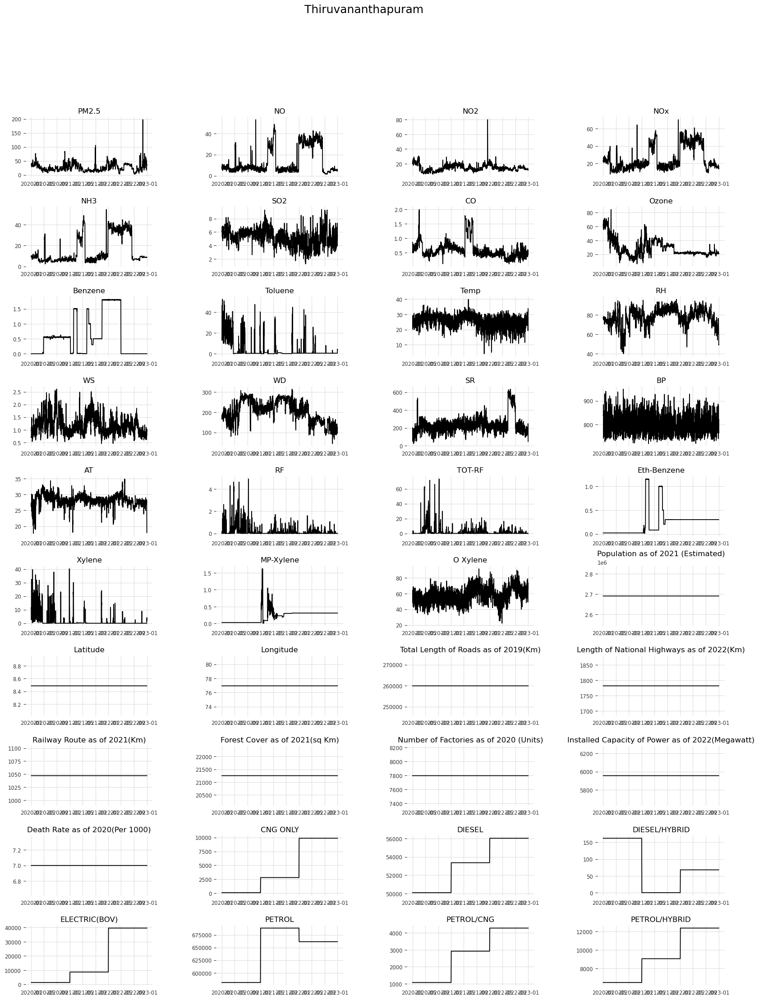

Agartala


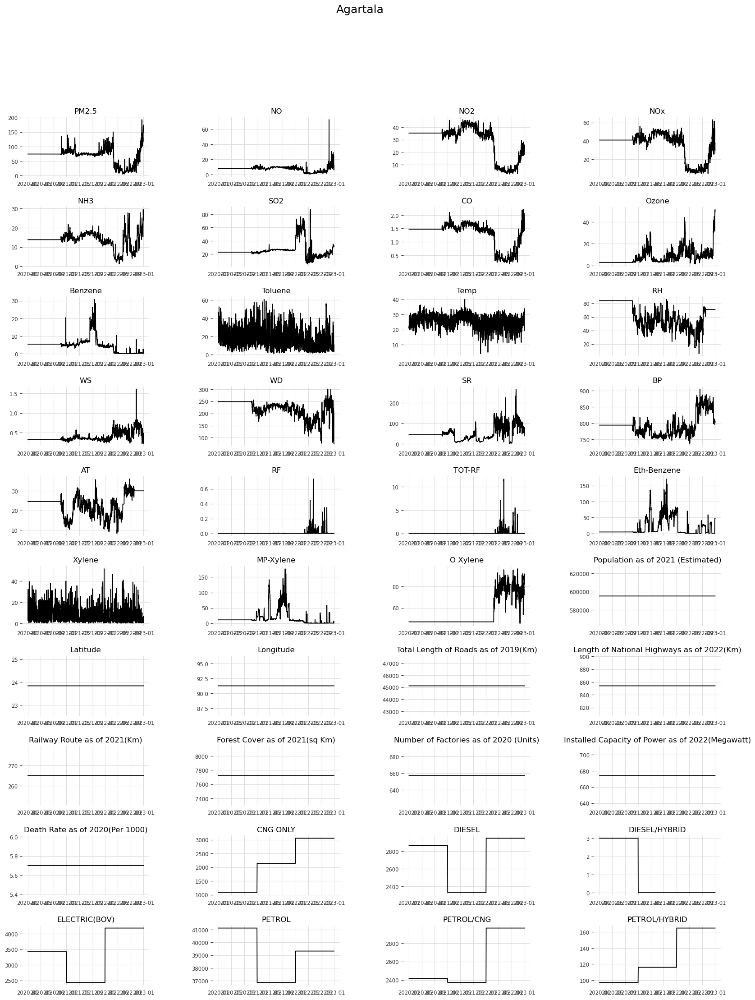

Gaya


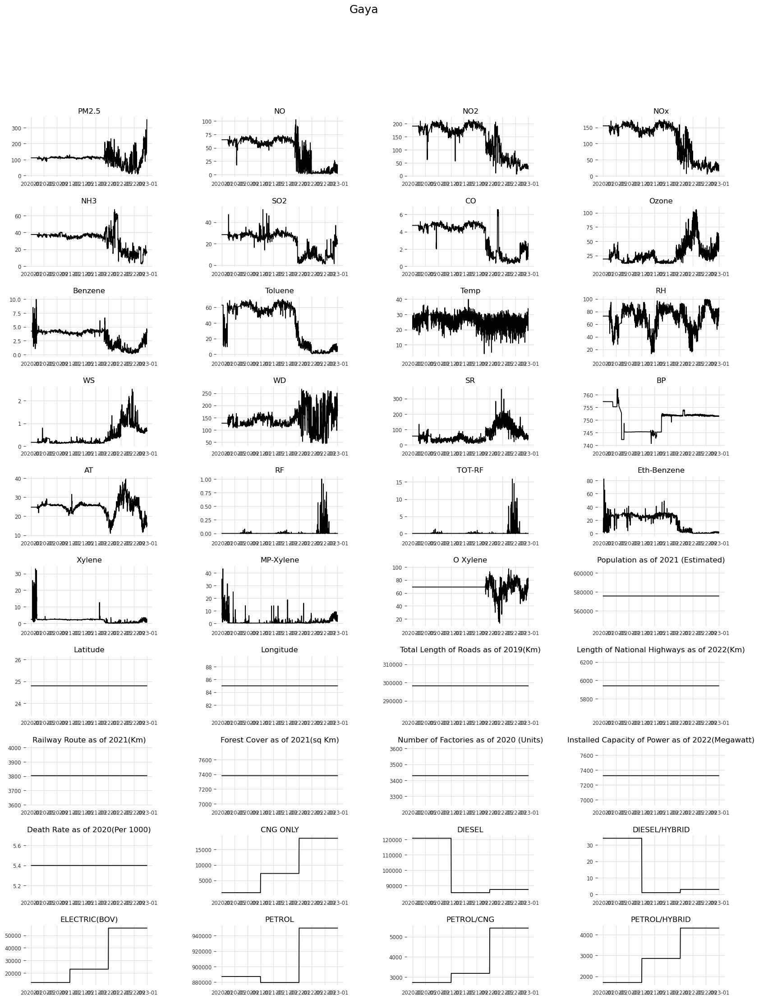

Muzaffarpur


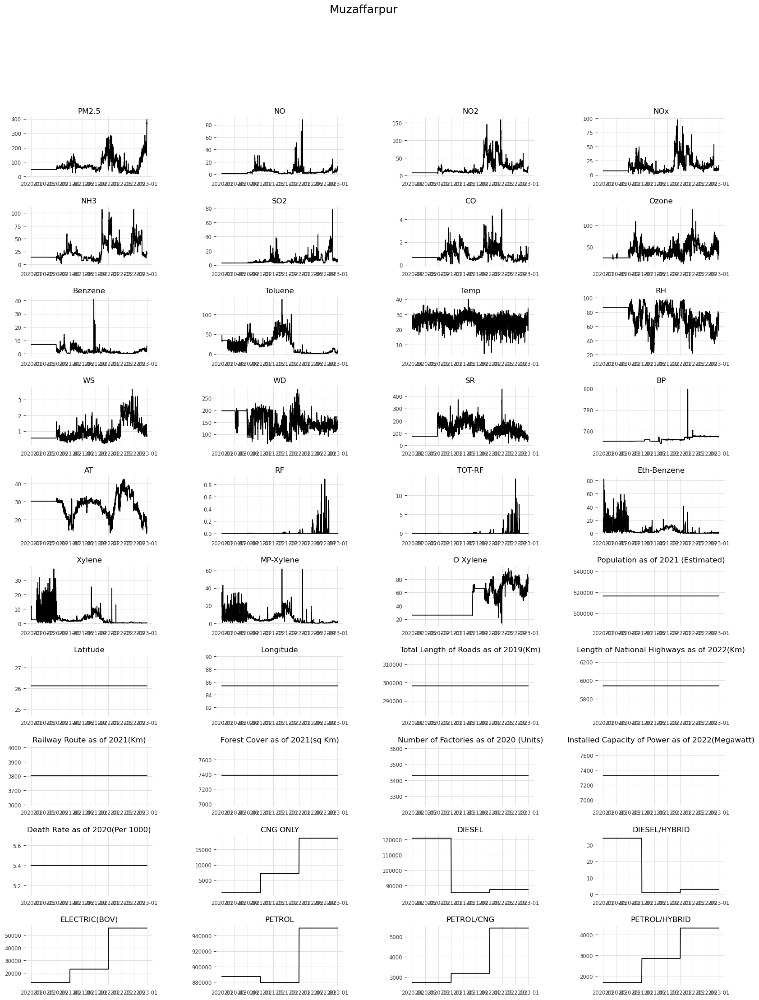

Patna


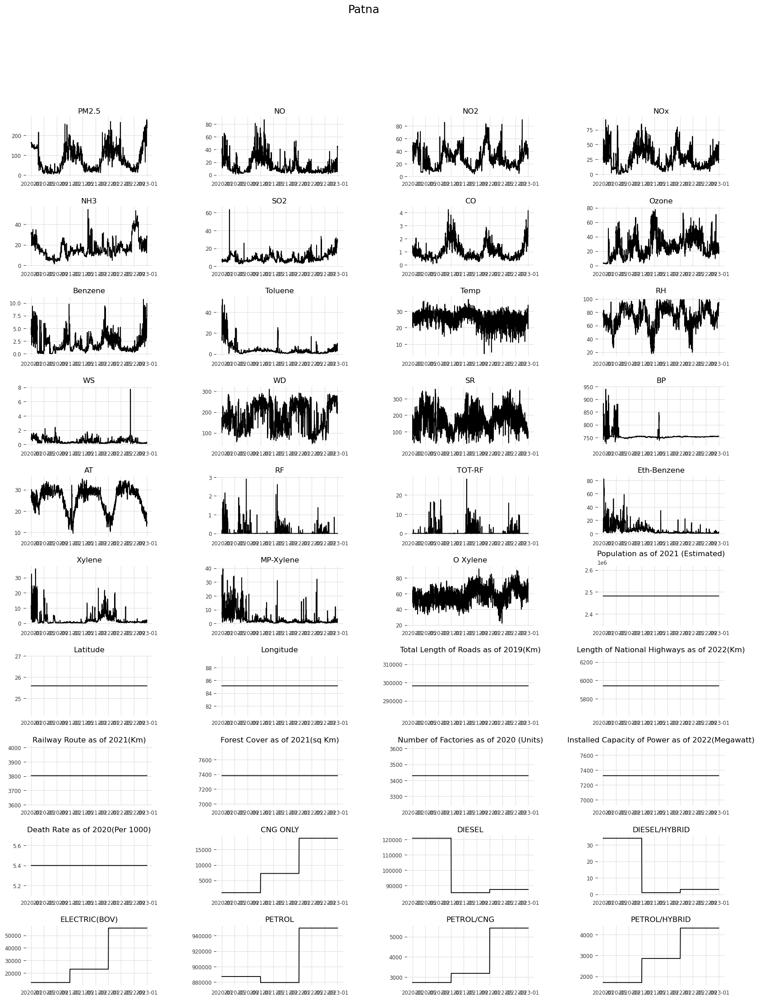

Srinagar


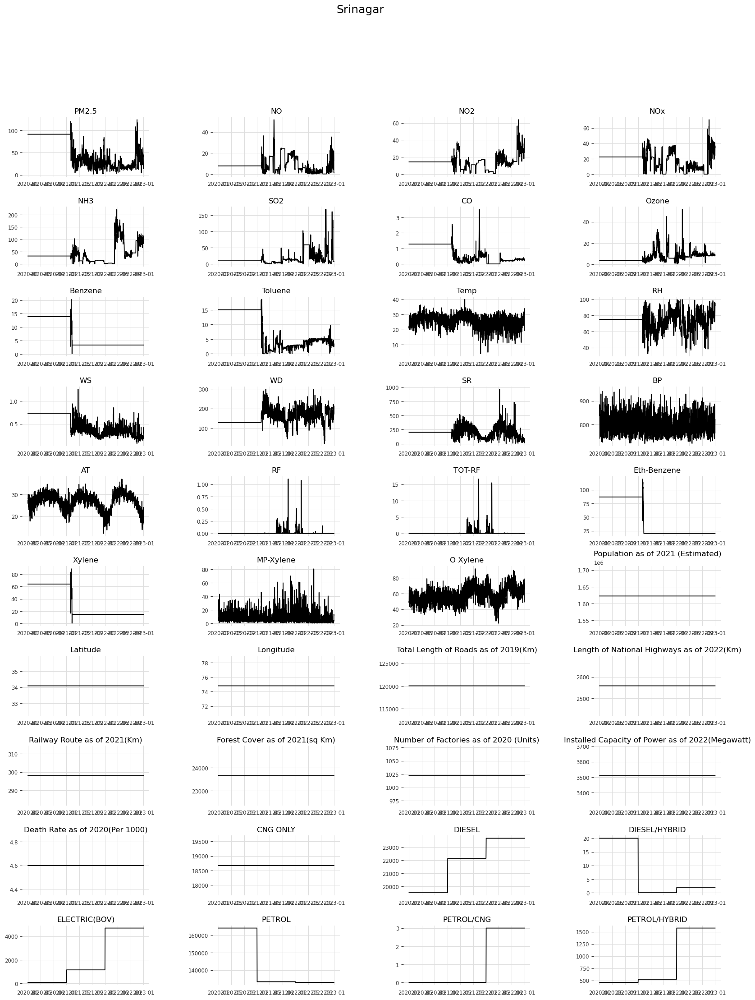

Howrah


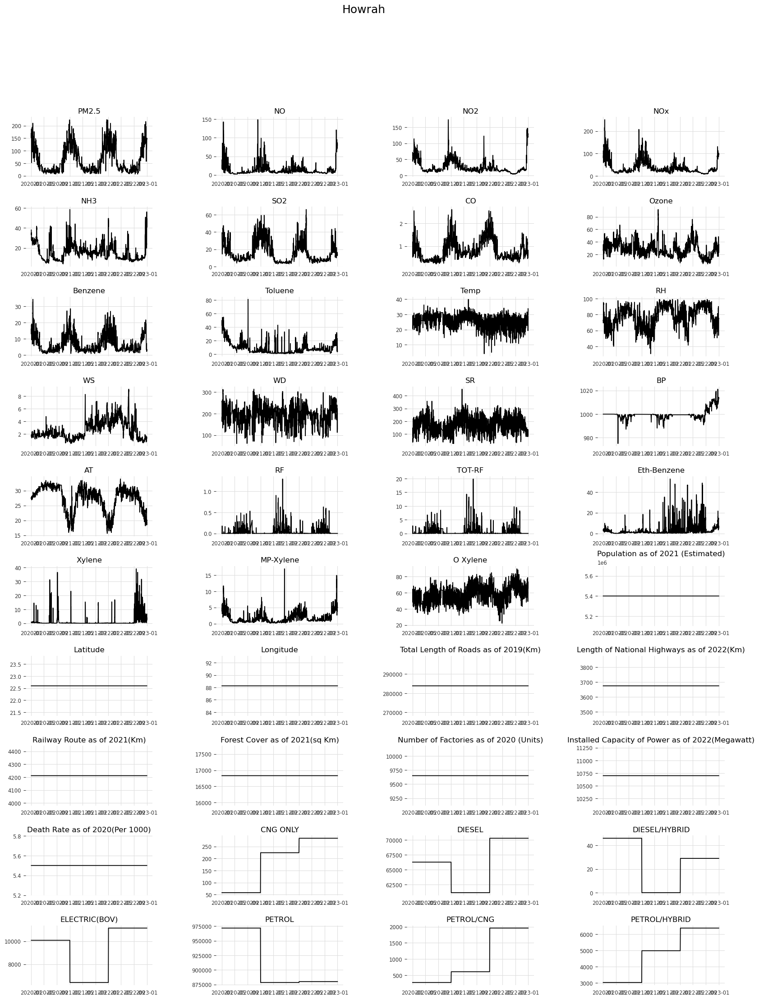

Kolkata


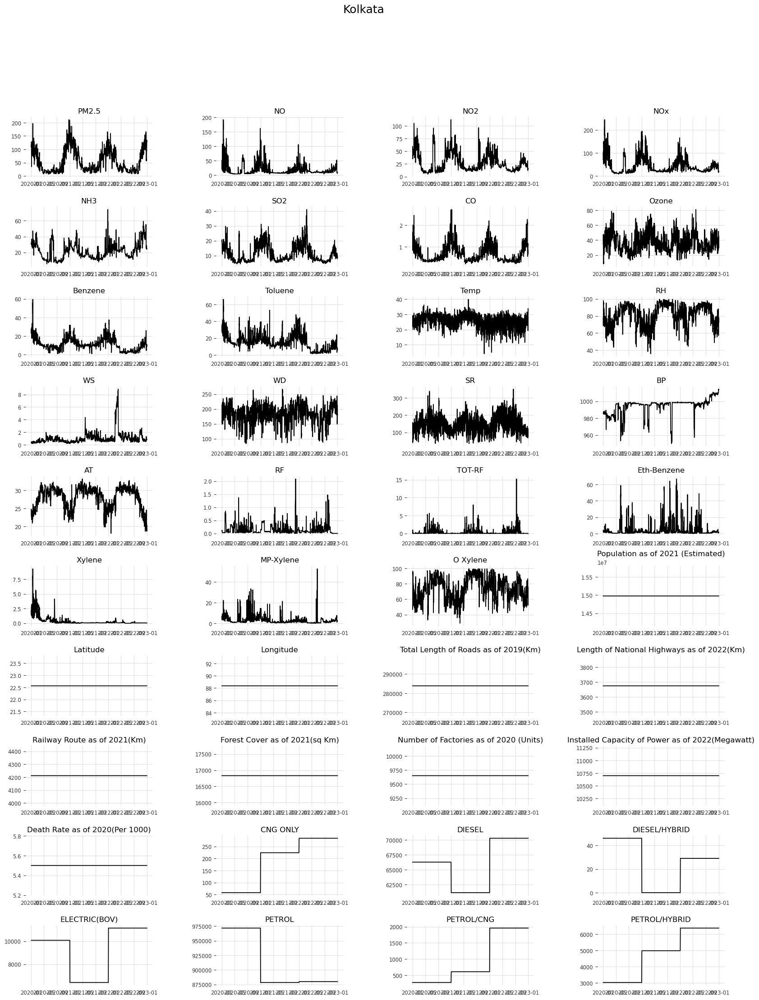

Bhopal


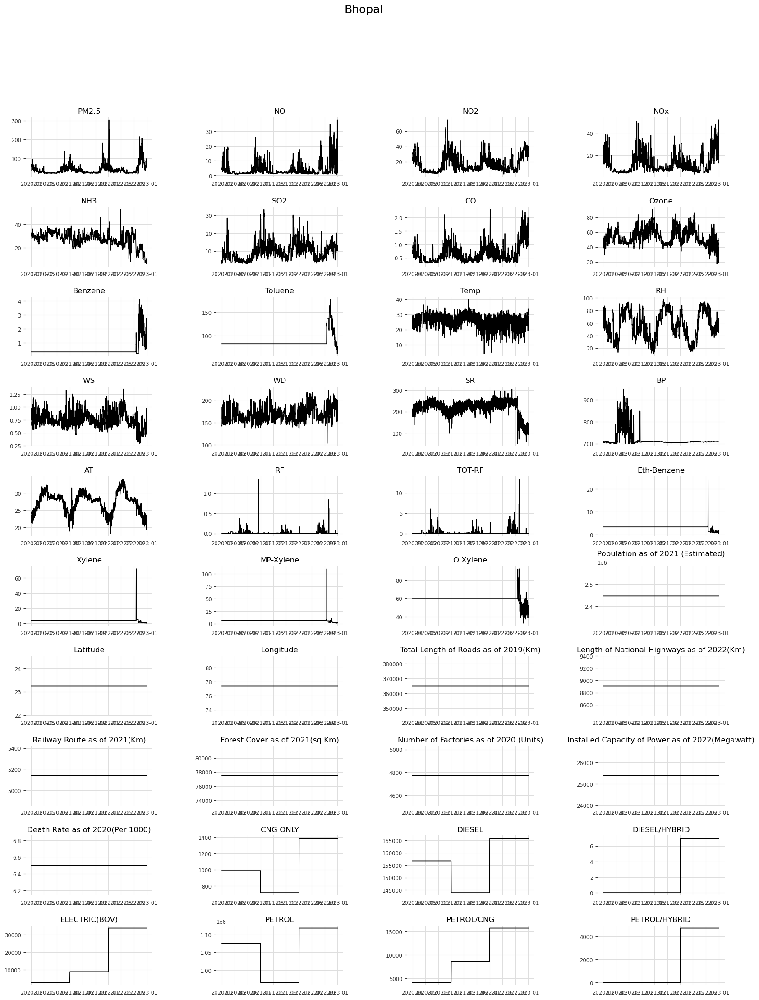

Gwalior


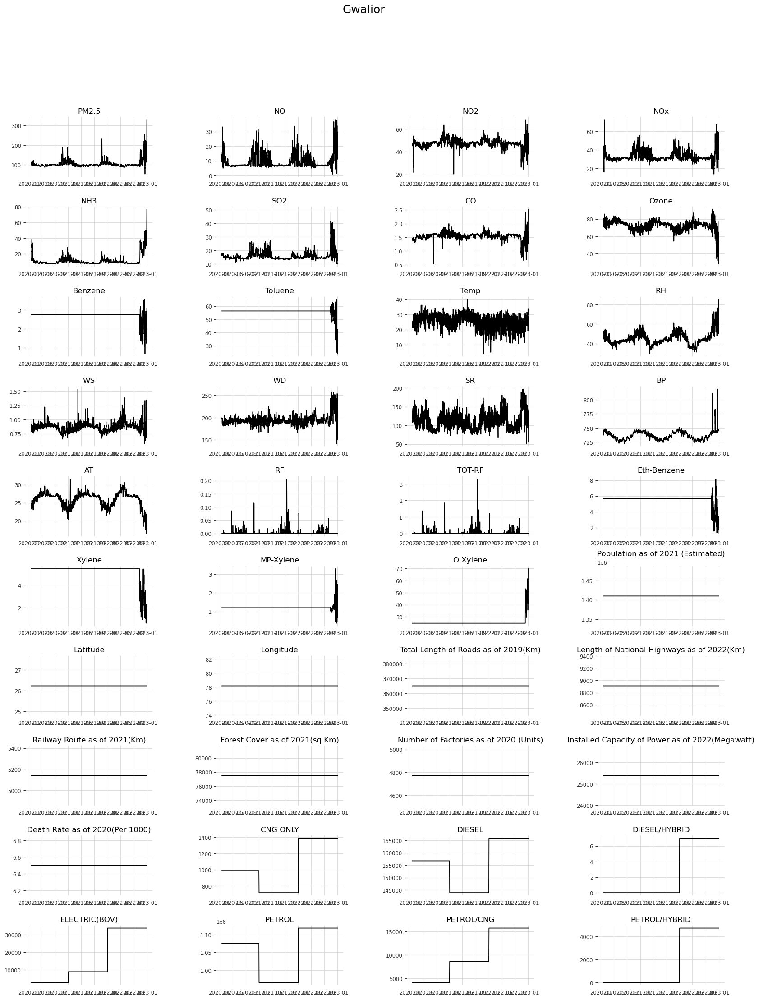

Bengaluru


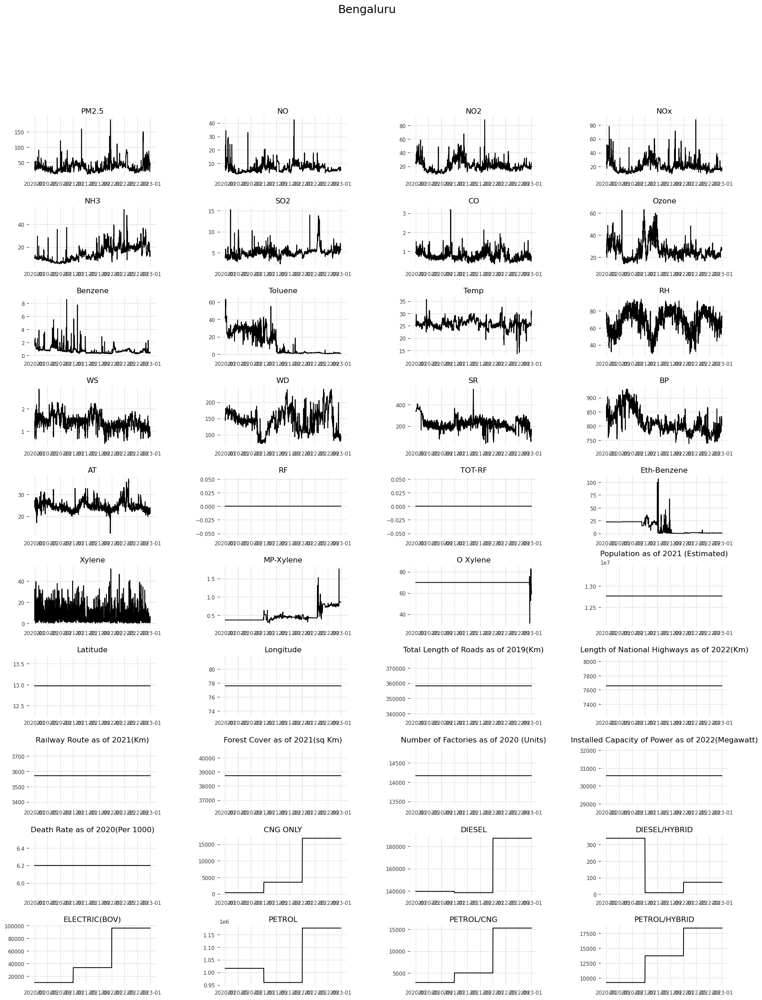

Raipur


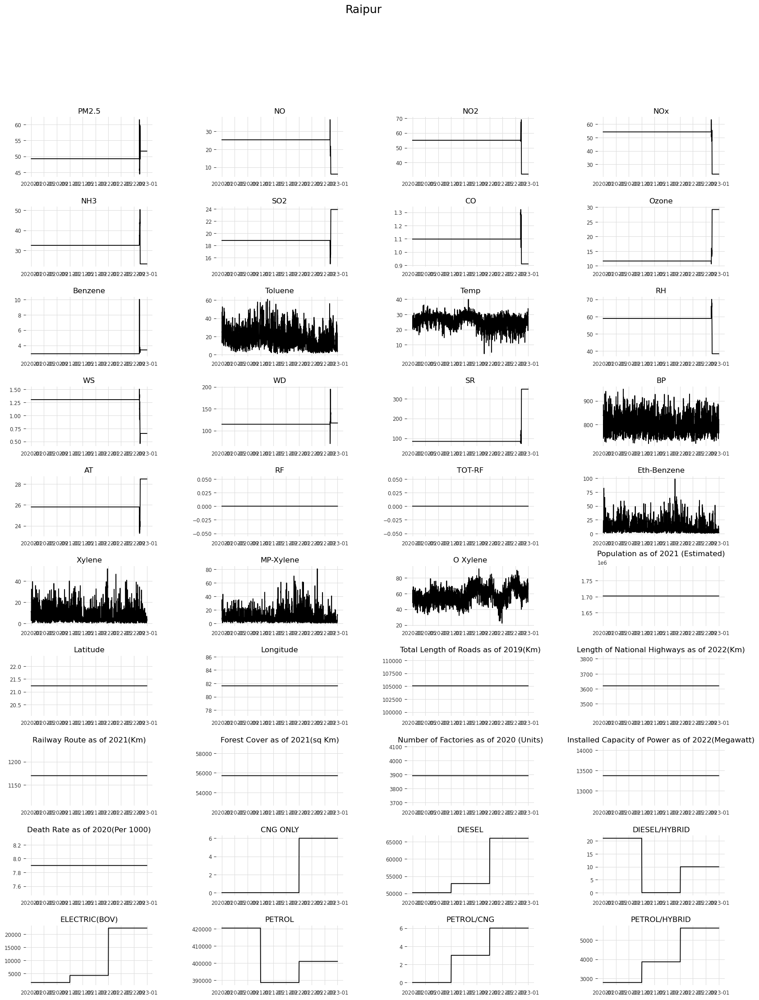

Bhilai


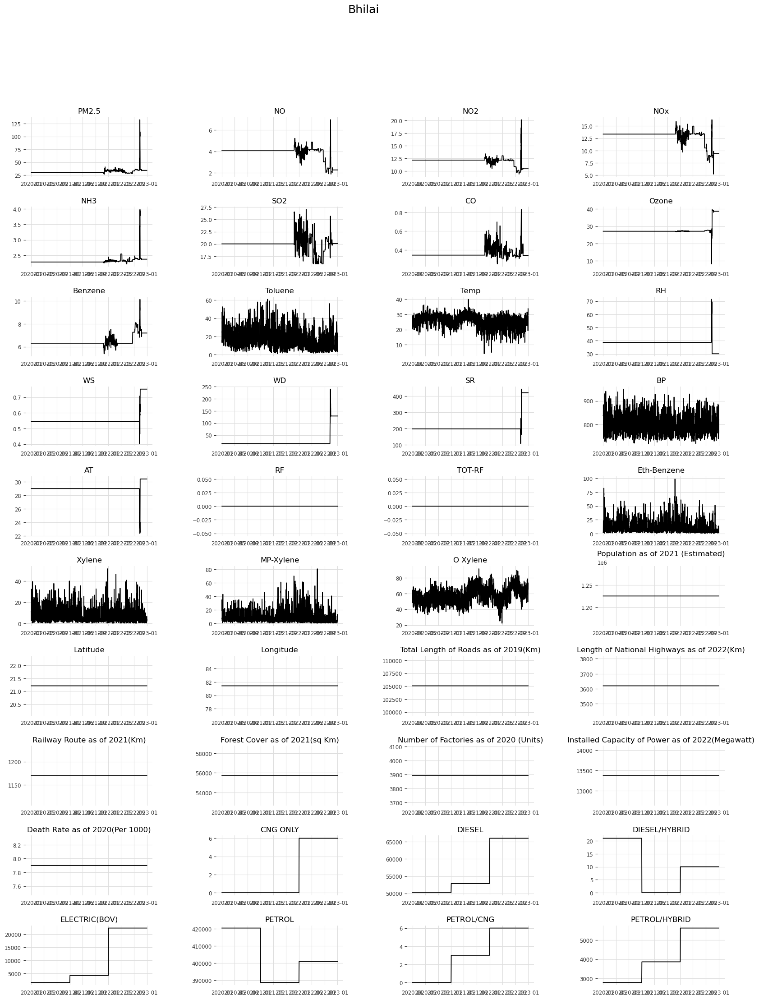

Chandigarh


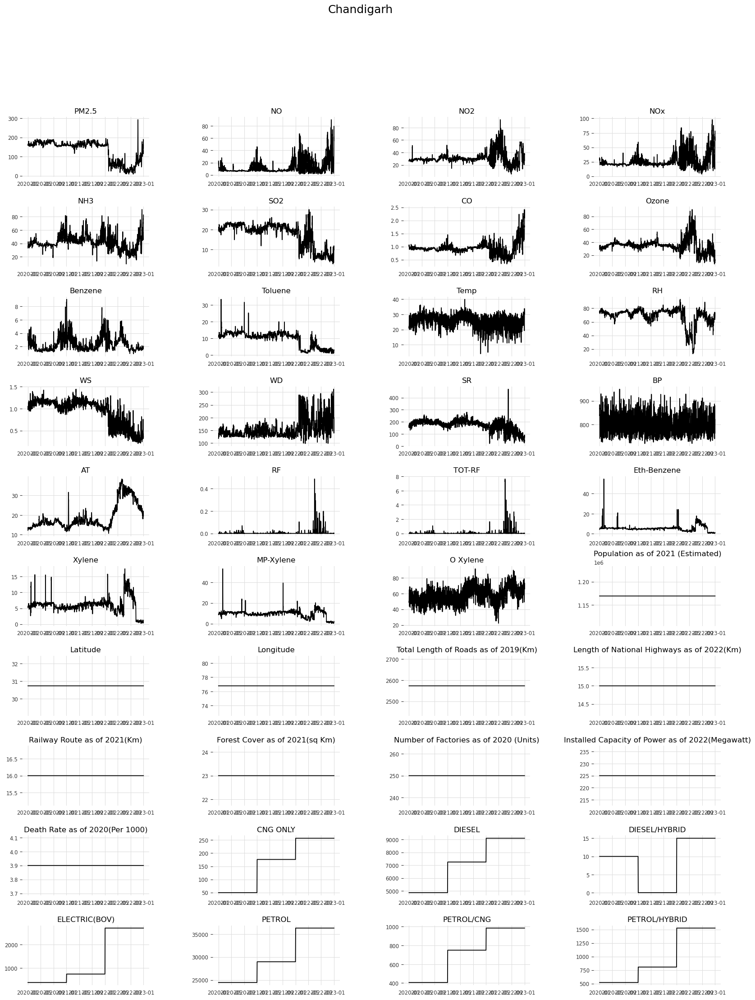

Chennai


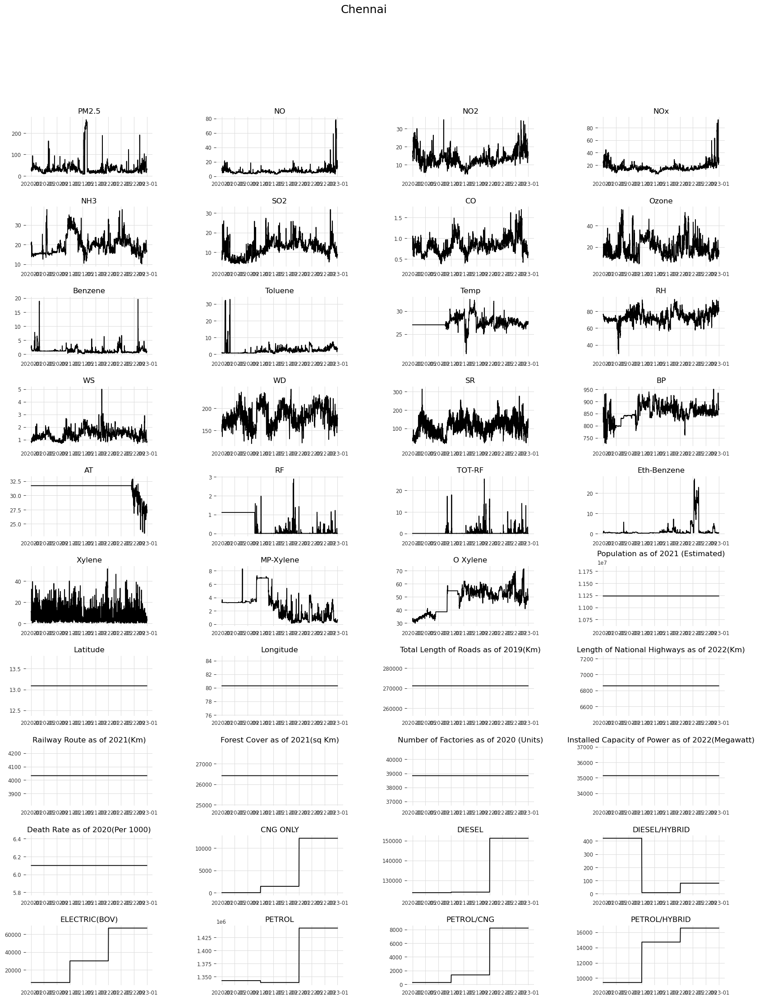

Mumbai


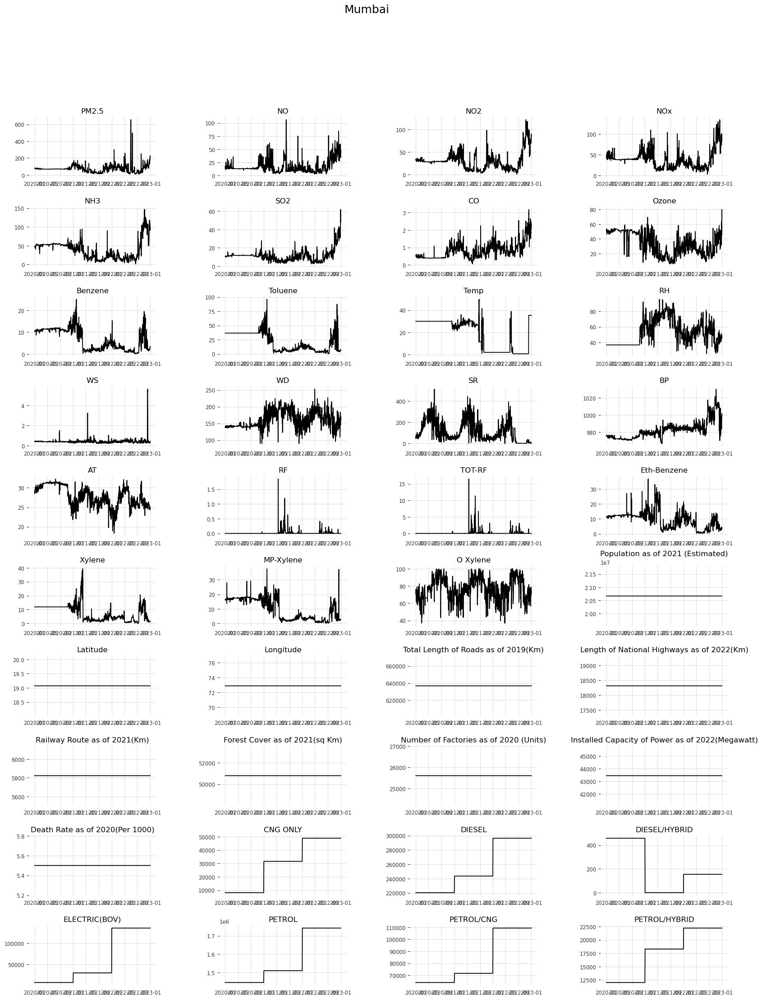

In [ ]:
#plot the data for all cities
for k in city_dic.keys():
    print(k)
    d = city_dic[k]
    fig, axs = plt.subplots(10, 4, figsize=(20, 25))
    fig.subplots_adjust(hspace=0.5, wspace=0.5)

    for i in range(10):
        for j in range(4):
            #print(viz_l[i*4+j])
            window_size = 7
            rolling_data = d[viz_l[i*4+j]].rolling(window=window_size).mean()
            axs[i][j].plot(rolling_data)
            axs[i][j].set_title(viz_l[i*4+j])

    # Set common labels and adjust spacing
    fig.suptitle(f'{k}',fontsize=18)
    # fig.tight_layout()
    plt.show()

# AD-Fuller Test

In [ ]:
from statsmodels.tsa.stattools import adfuller
stationary = []
non_st = []
for i in city_dic.keys():
    print(i)
    result = adfuller(city_dic[i]['PM2.5'])
    print('ADF Statistic:', result[0])
    print('p-value:', result[1])
    print('Critical Values:')
    for key, value in result[4].items():
        print('\t%s: %.3f' % (key, value))

    if result[1] < 0.05:
        print('The data is stationary, and time series forecasting can be applied.')
        stationary.append(i)
    else:
        print('The data is not stationary, and time series forecasting may not be applicable.')
        non_st.append(i)
    print("\n")

Delhi
ADF Statistic: -5.2627733443727625
p-value: 6.536466148072842e-06
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
The data is stationary, and time series forecasting can be applied.


Ahmedabad
ADF Statistic: -7.43637681643661
p-value: 6.167895775821591e-11
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
The data is stationary, and time series forecasting can be applied.


Gandhinagar
ADF Statistic: -8.615970599474162
p-value: 6.289330024045745e-14
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
The data is stationary, and time series forecasting can be applied.


Lucknow
ADF Statistic: -5.585150695638751
p-value: 1.3683002047451779e-06
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
The data is stationary, and time series forecasting can be applied.


Varanasi
ADF Statistic: -4.408275065436883
p-value: 0.0002869815740345739
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
The data is stationary, and time series forecasting can be applied.


Meerut
AD

In [ ]:
stationary #All the stationay PM2.5 Cities

['Delhi',
 'Ahmedabad',
 'Gandhinagar',
 'Lucknow',
 'Varanasi',
 'Meerut',
 'Prayagraj',
 'Ghaziabad',
 'Agra',
 'Noida',
 'Kanpur',
 'Guwahati',
 'Faridabad',
 'Gurugram',
 'Jaipur',
 'Kota',
 'Imphal',
 'Thiruvananthapuram',
 'Gaya',
 'Patna',
 'Howrah',
 'Kolkata',
 'Bhopal',
 'Gwalior',
 'Bengaluru',
 'Bhilai',
 'Chennai',
 'Mumbai']

# Seasonal Decomposition and ACF-PACF plots

In [ ]:
def decompose_bike_sharing_demand(df, share_type='count', samples=250, period=24):
    if samples == 'all':
        #decomposing all time series timestamps
        res = seasonal_decompose(df[share_type].values, period=period)
    else:
        #decomposing a sample of the time series
        res = seasonal_decompose(df[share_type].values[-samples:], period=period)

    observed = res.observed
    trend = res.trend
    seasonal = res.seasonal
    residual = res.resid

    #plot the complete time series
    fig, axs = plt.subplots(4, figsize=(16,8))
    axs[0].set_title('OBSERVED', fontsize=16)
    axs[0].plot(observed)
    axs[0].grid()

    #plot the trend of the time series
    axs[1].set_title('TREND', fontsize=16)
    axs[1].plot(trend)
    axs[1].grid()

    #plot the seasonality of the time series. Period=24 daily seasonality | Period=24*7 weekly seasonality.
    axs[2].set_title('SEASONALITY', fontsize=16)
    axs[2].plot(seasonal)
    axs[2].grid()

    #plot the noise of the time series
    axs[3].set_title('NOISE', fontsize=16)
    axs[3].plot(residual)
    axs[3].scatter(y=residual, x=range(len(residual)), alpha=0.5)
    axs[3].grid()

    plt.show()

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

Delhi


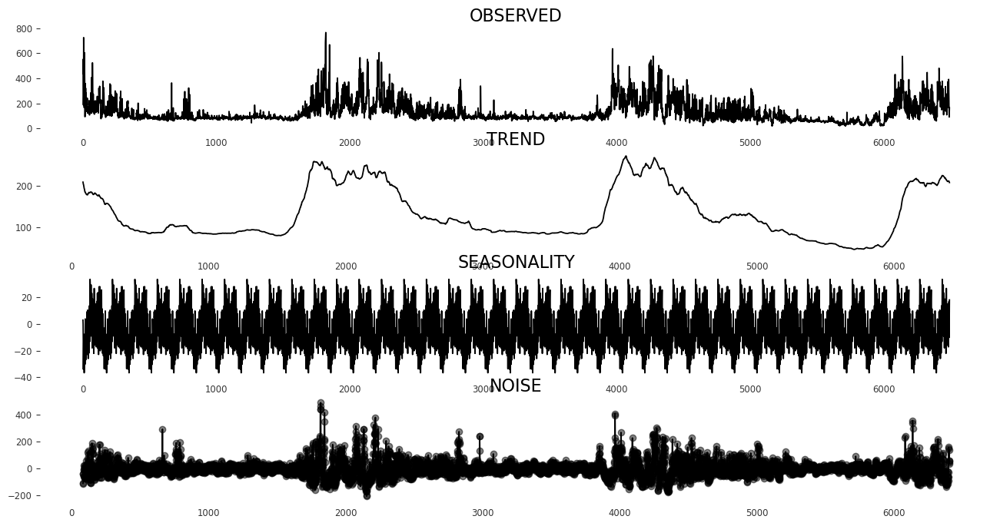



Ahmedabad


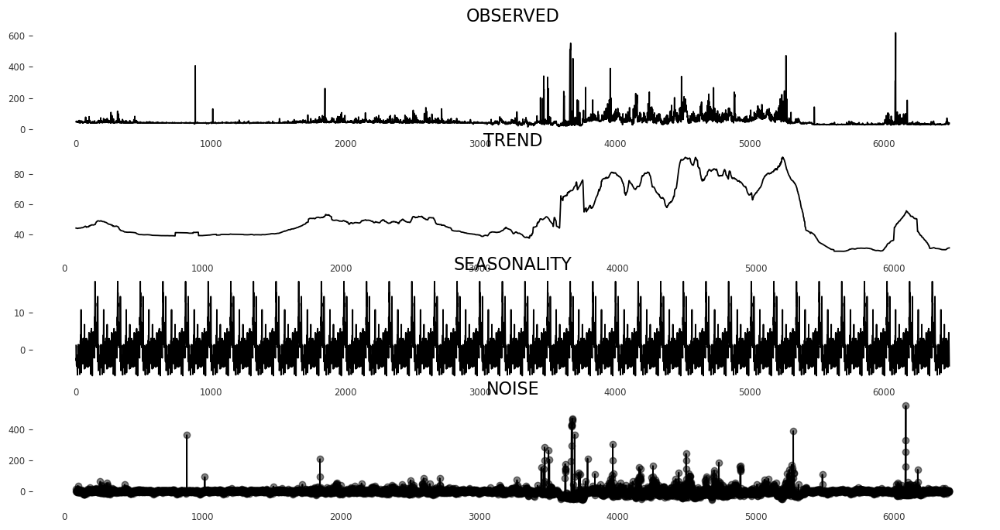



Gandhinagar


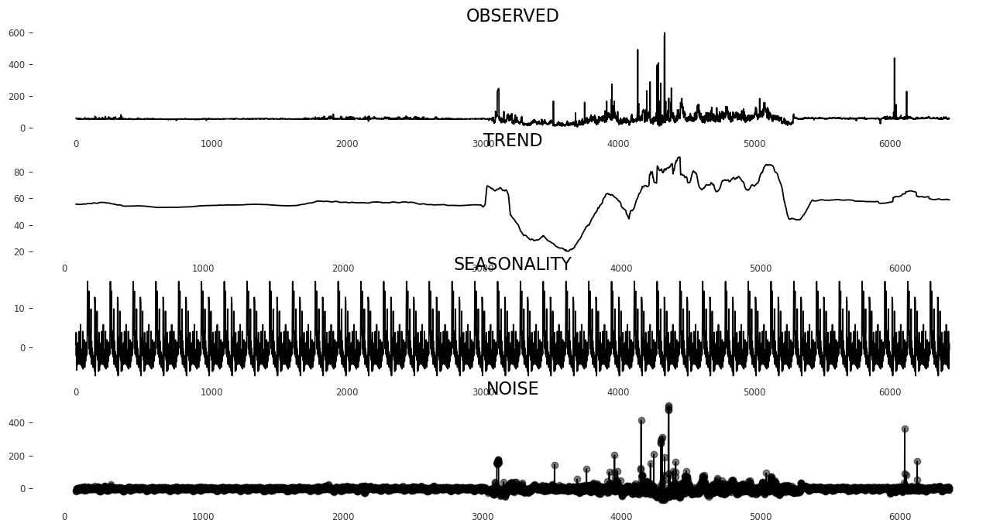



Lucknow


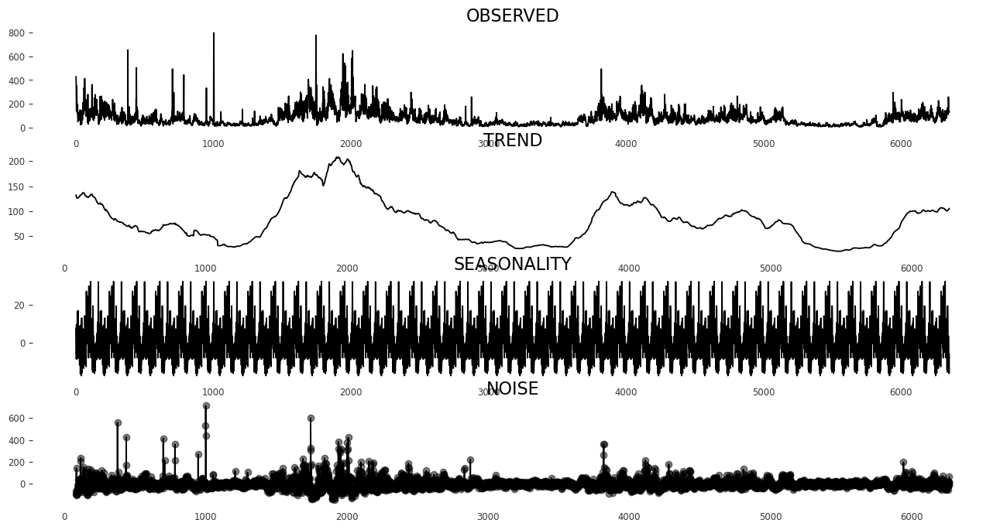



Varanasi


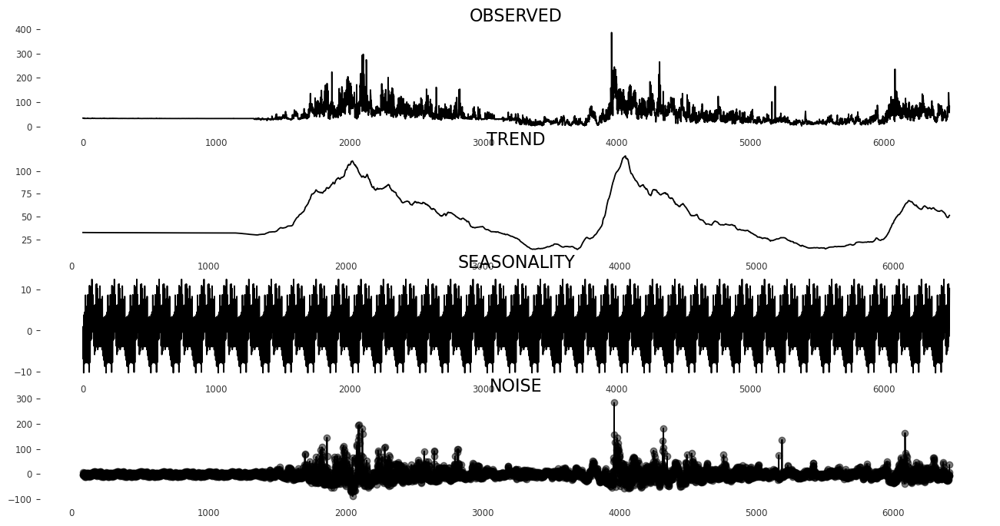



Meerut


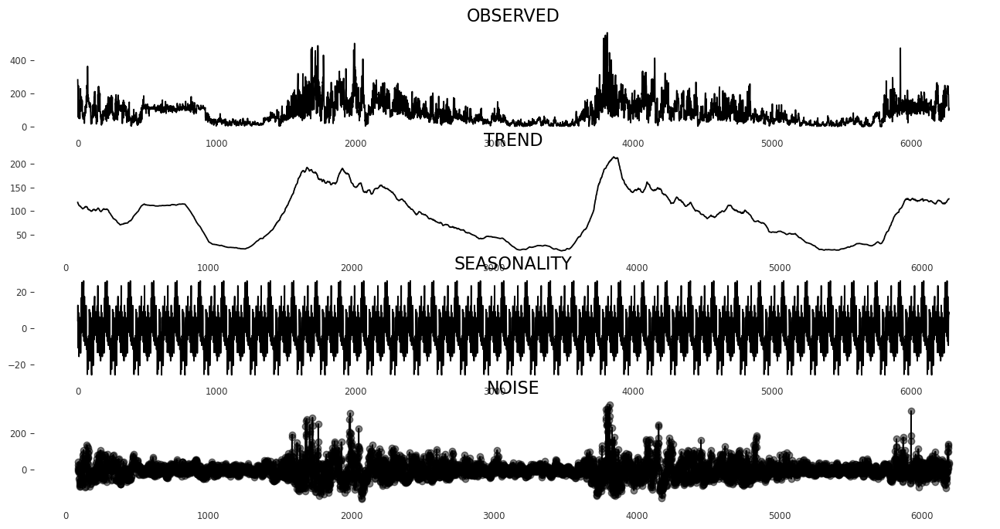



Prayagraj


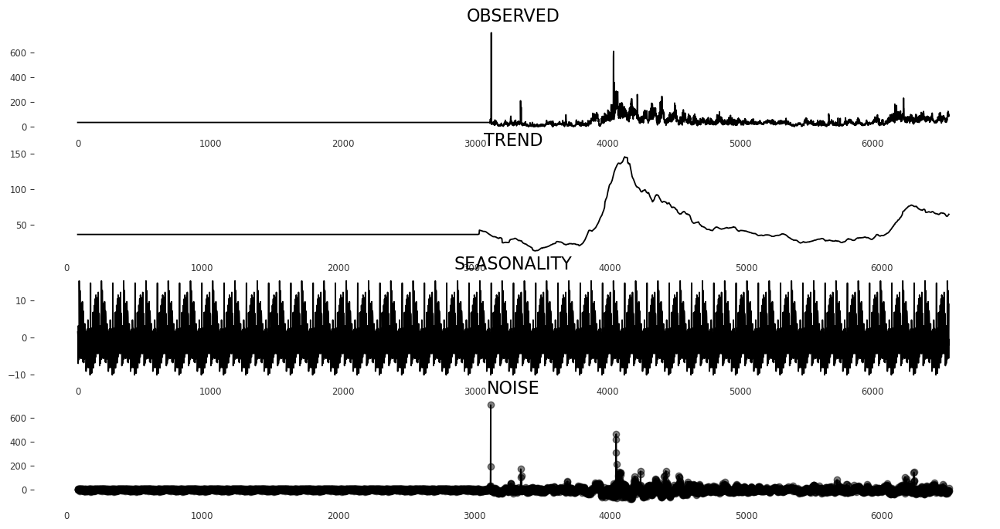



Ghaziabad


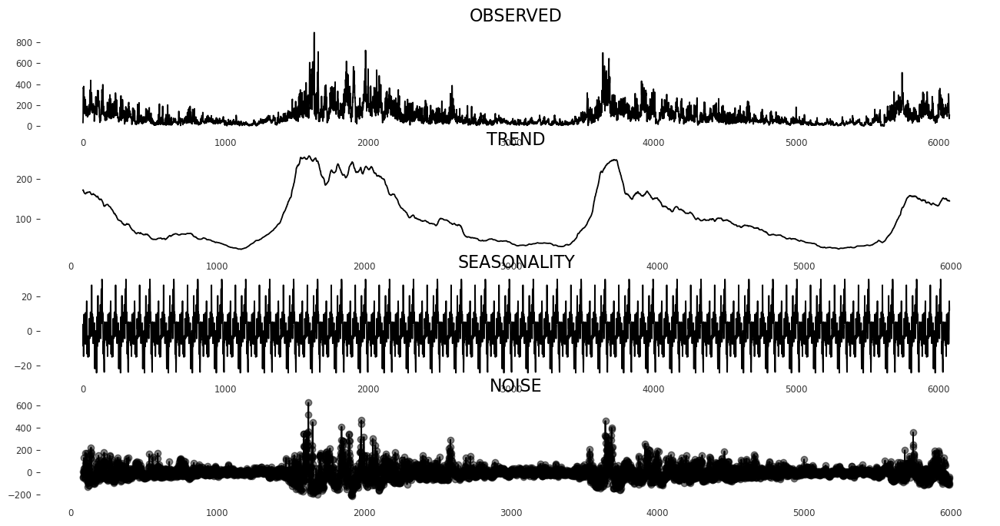



Agra


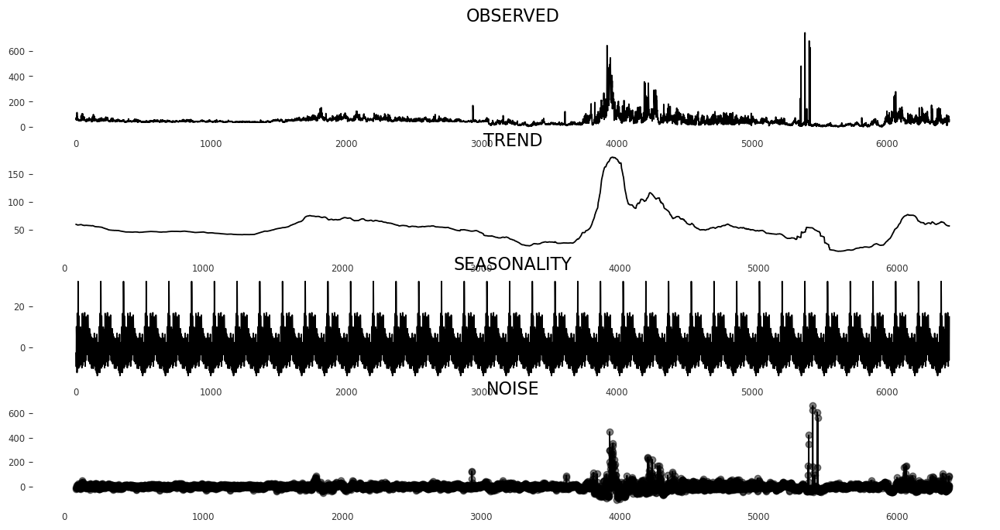



Noida


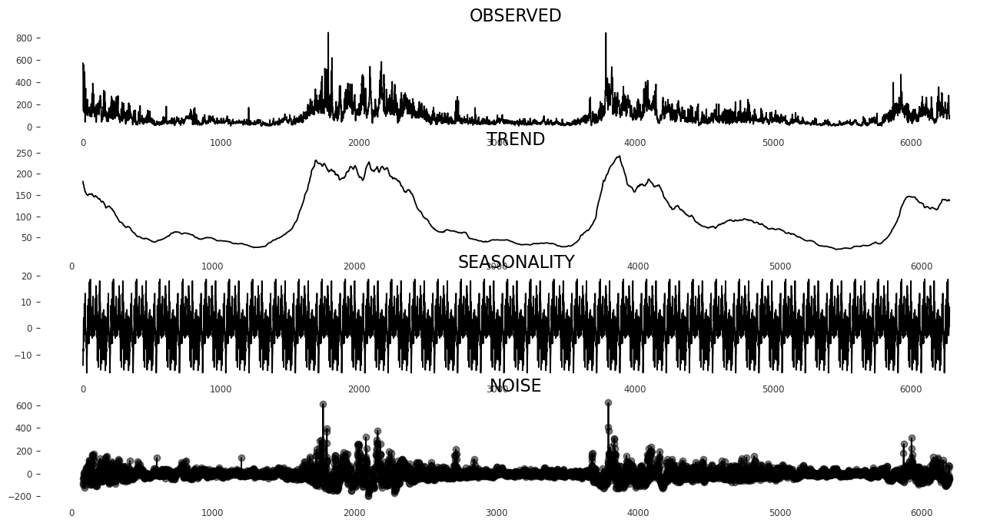



Kanpur


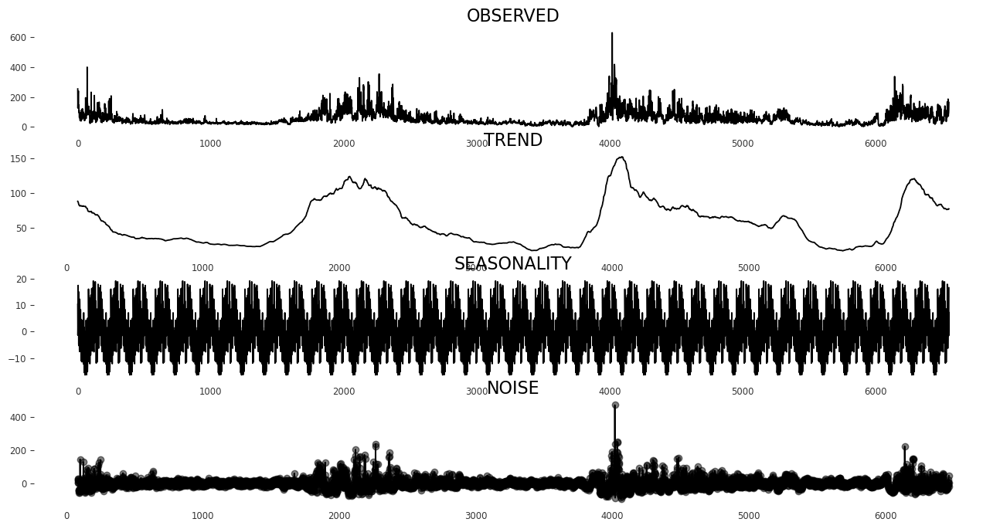



Moradabad


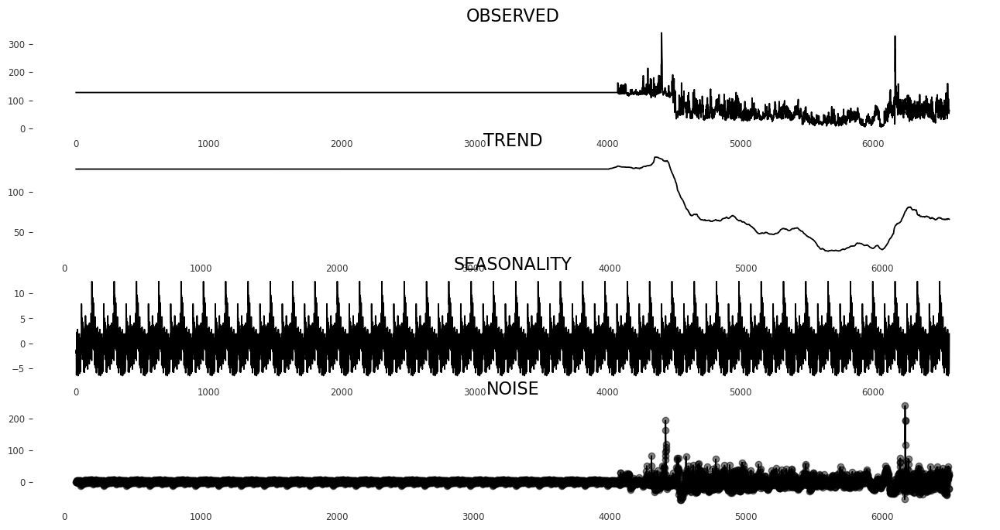



Guwahati


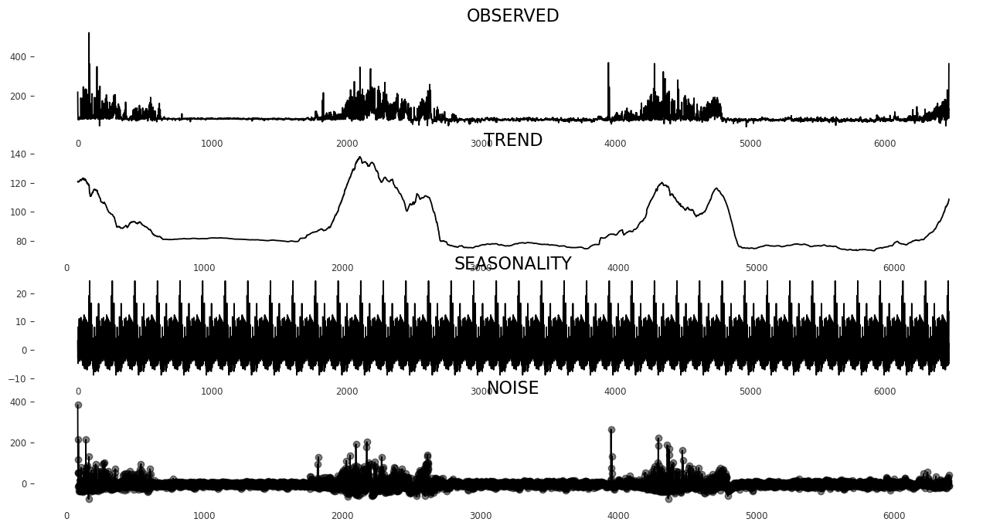



Faridabad


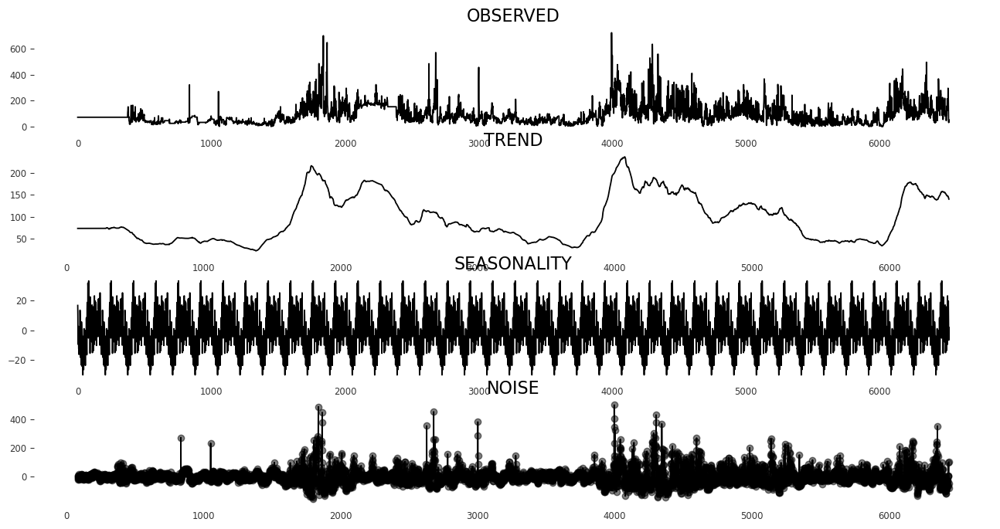



Gurugram


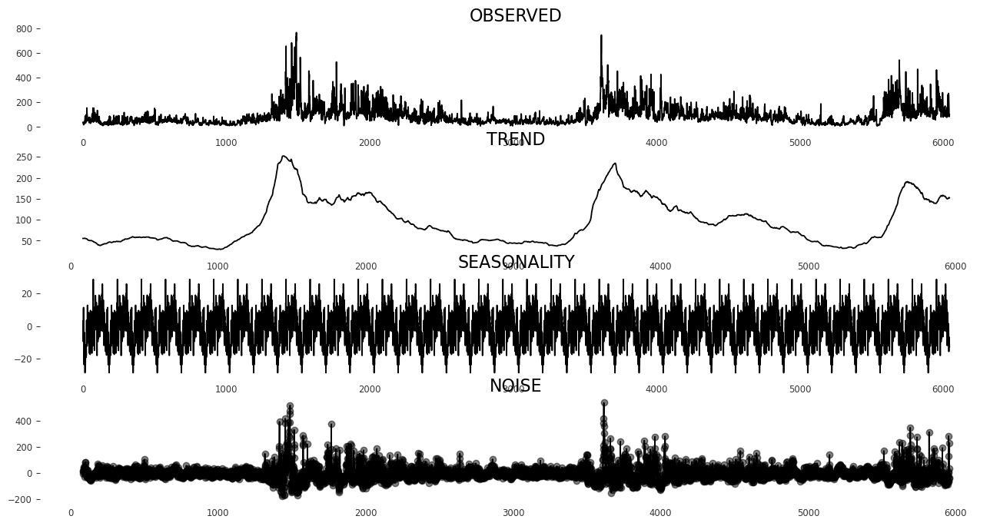



Jaipur


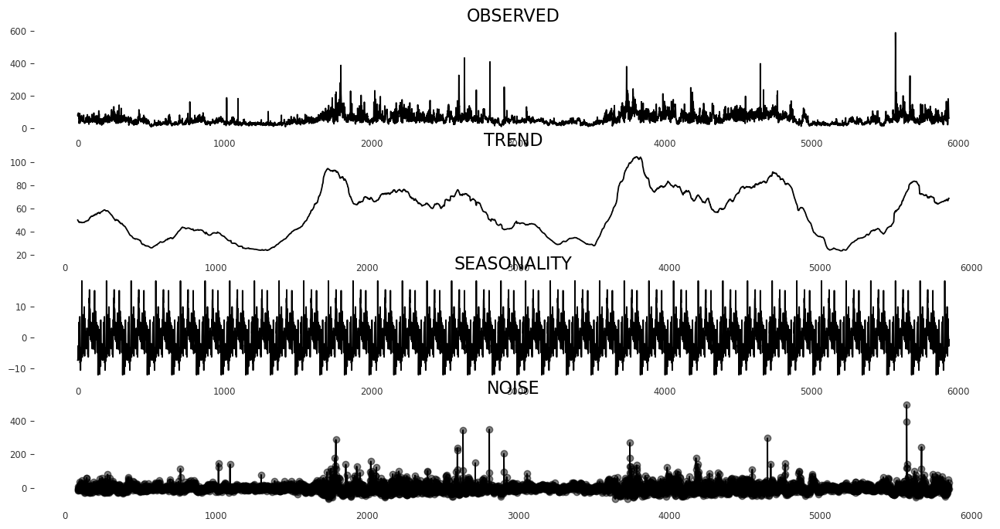



Kota


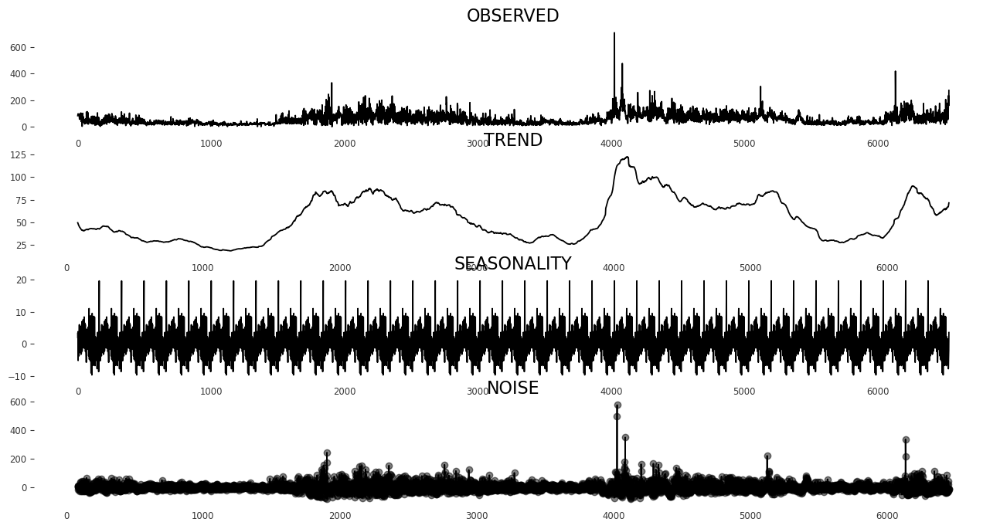



Imphal


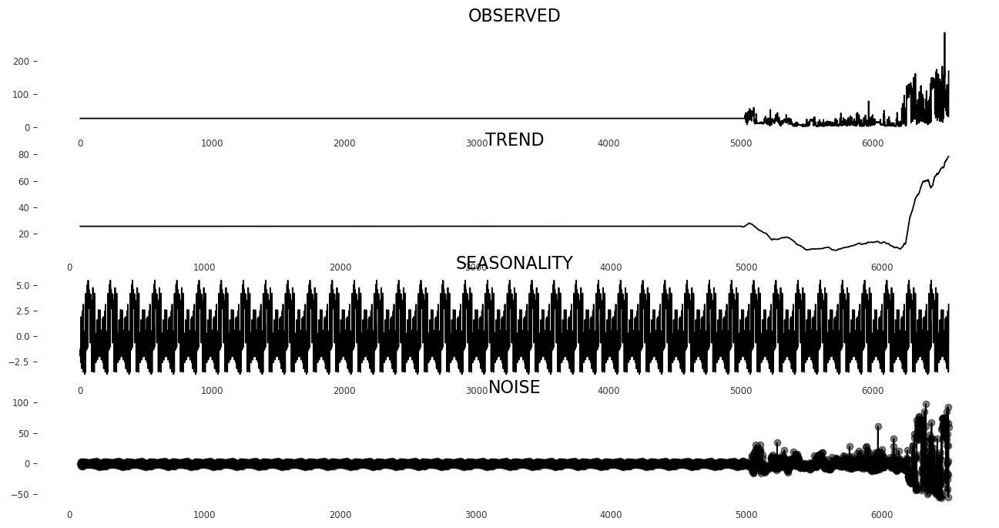



Thiruvananthapuram


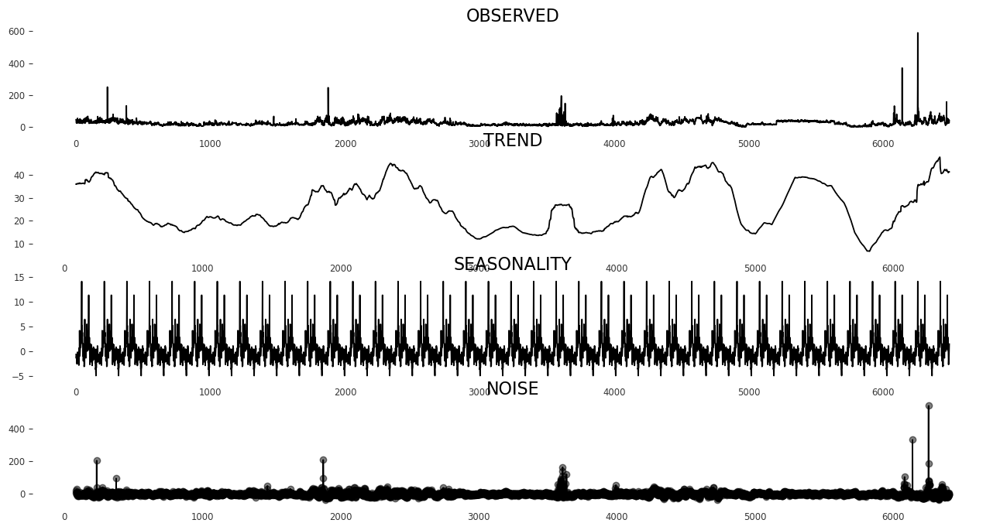



Agartala


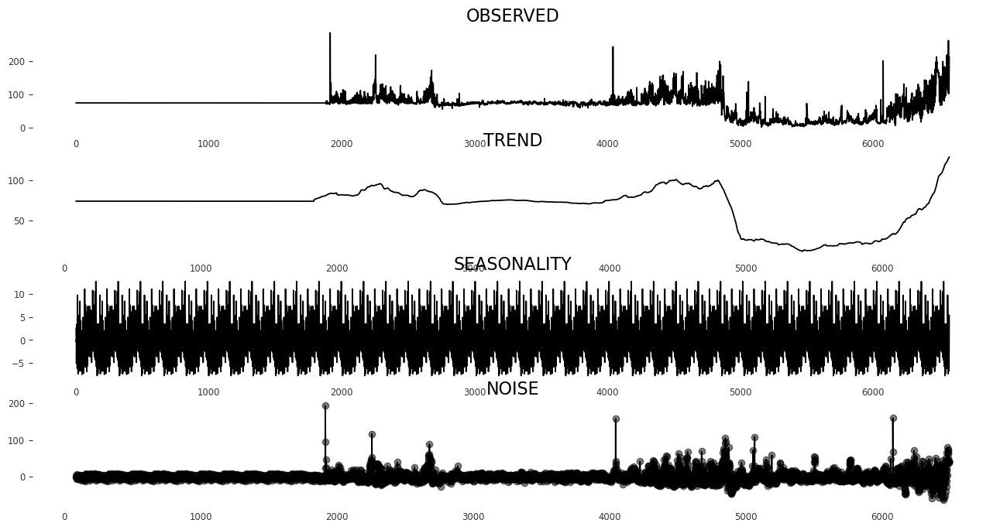



Gaya


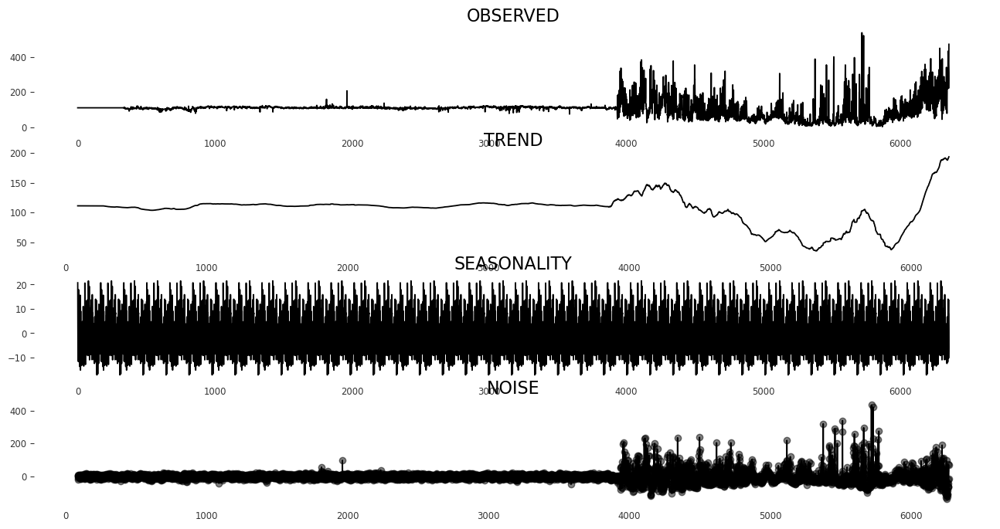



Muzaffarpur


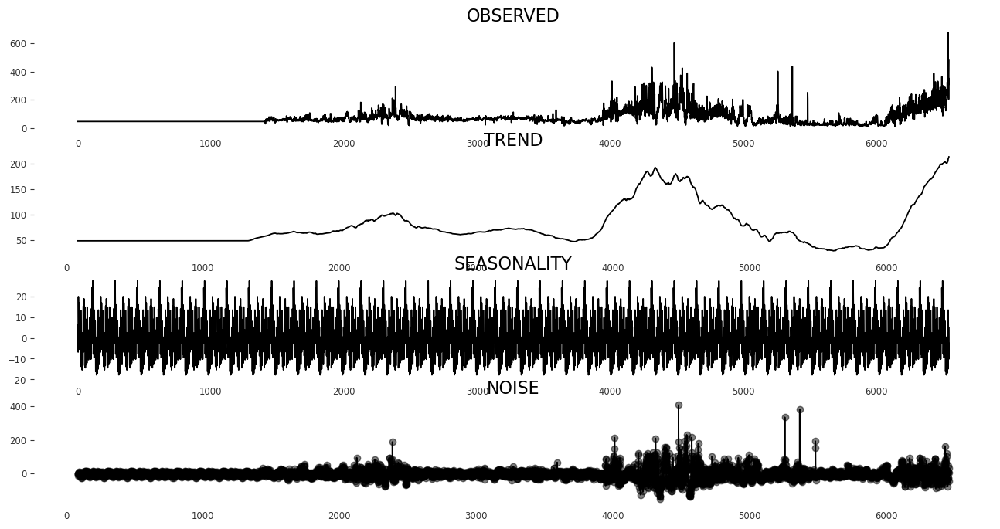



Patna


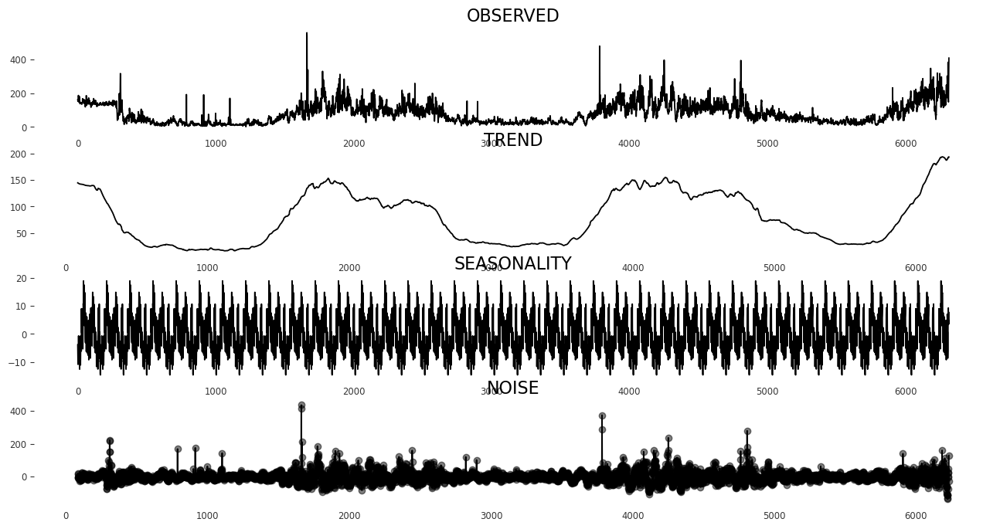



Srinagar


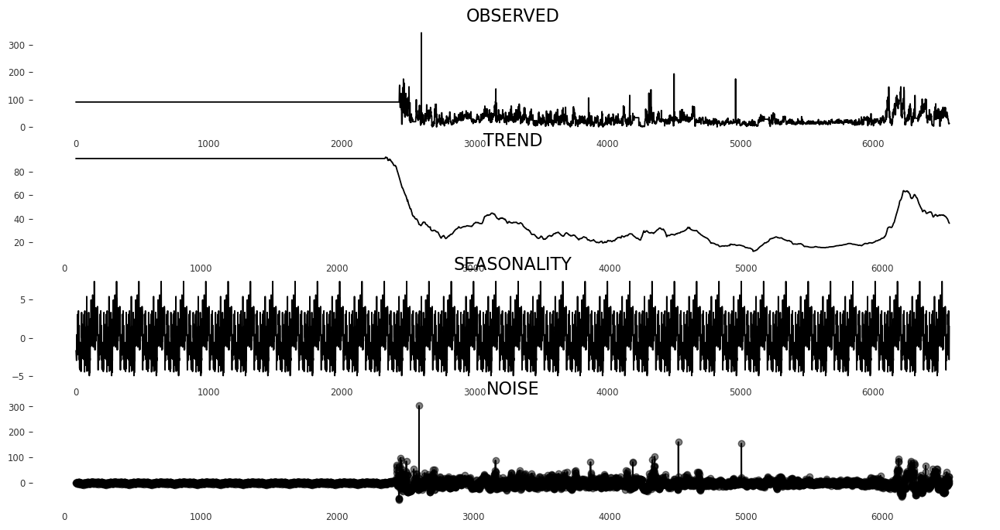



Howrah


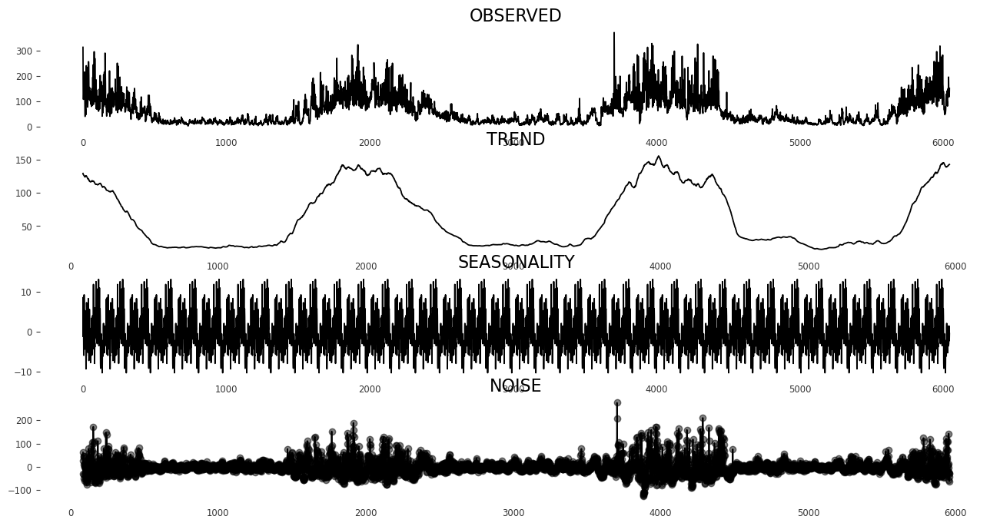



Kolkata


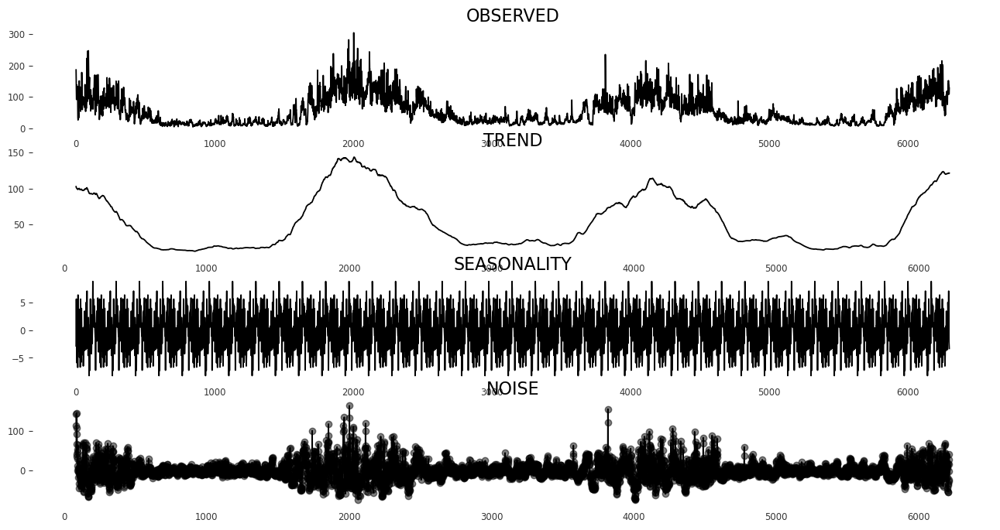



Bhopal


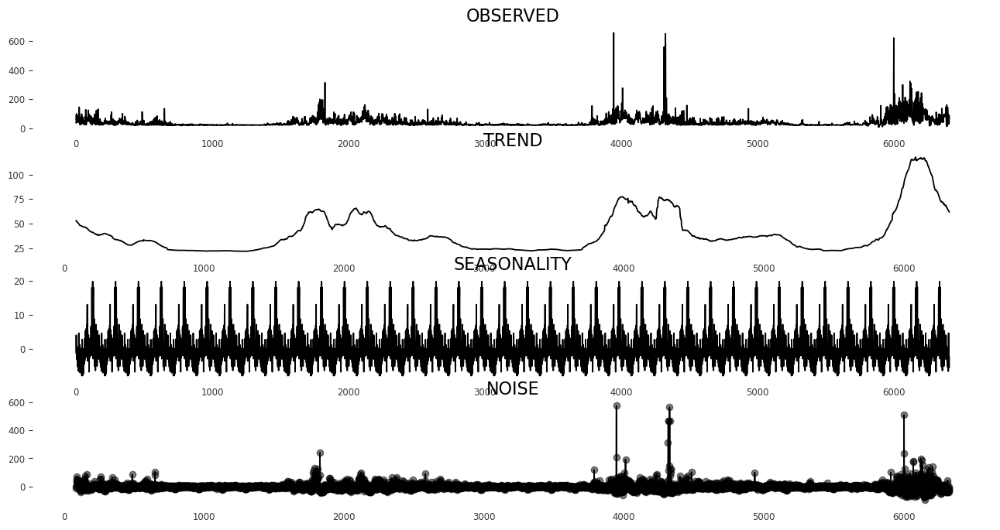



Gwalior


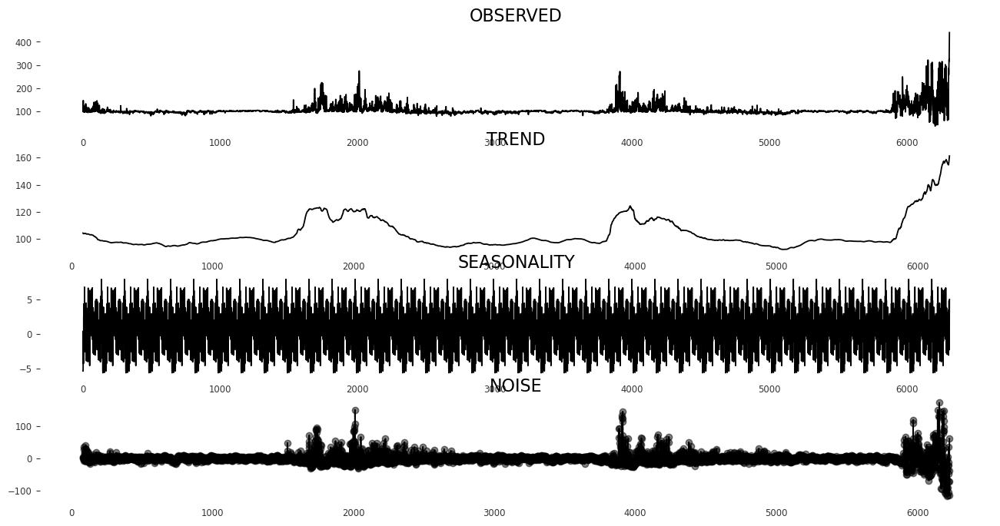



Bengaluru


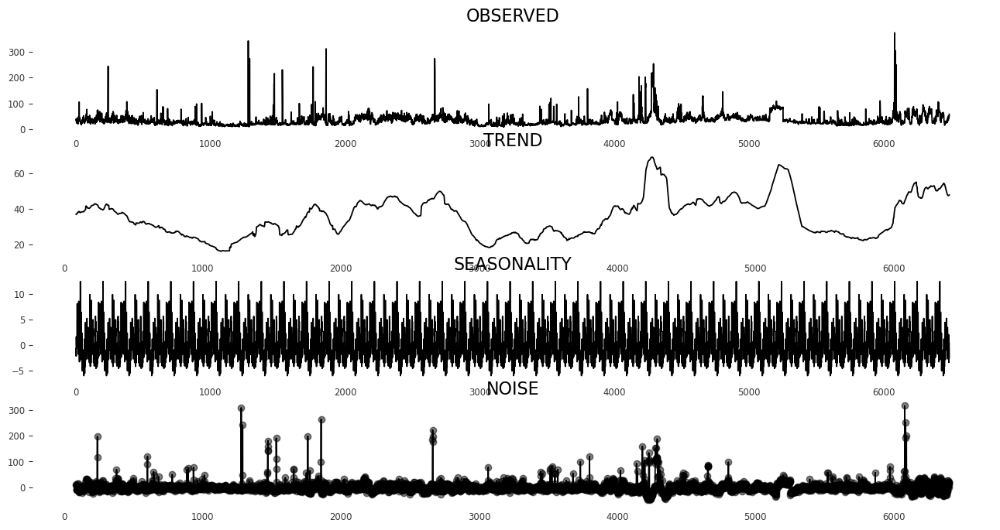



Raipur


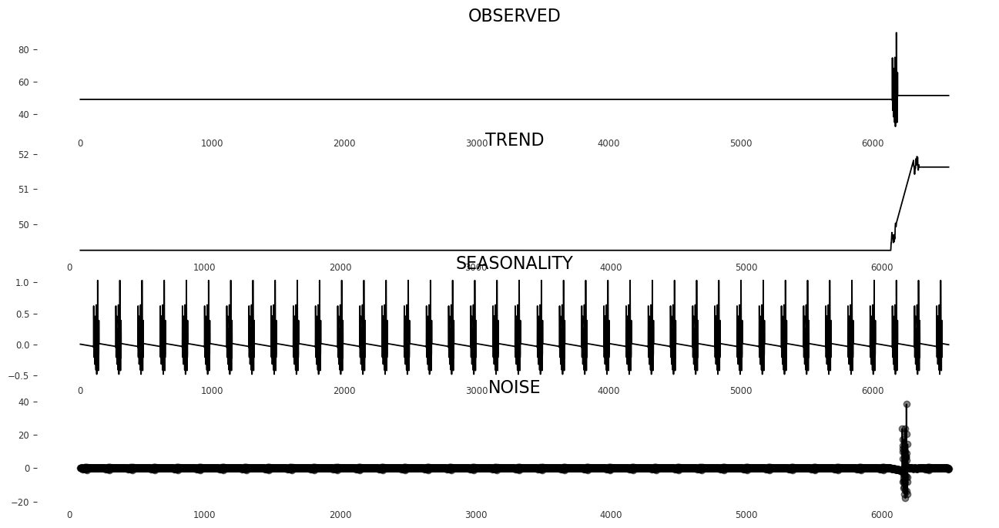



Bhilai


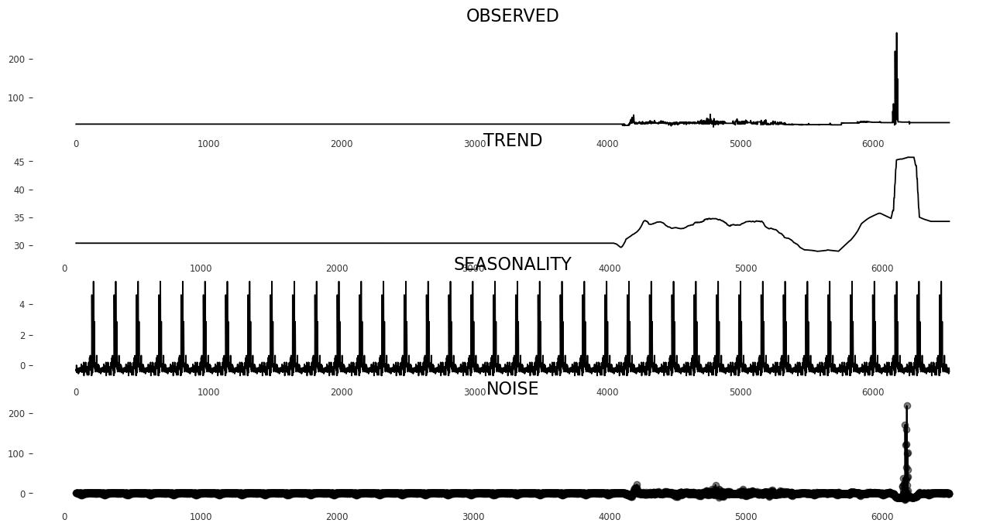



Chandigarh


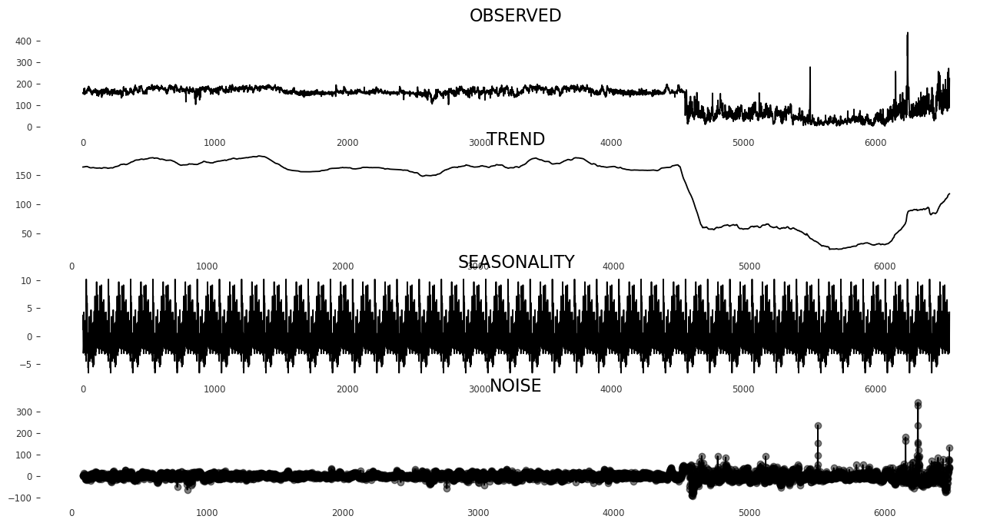



Chennai


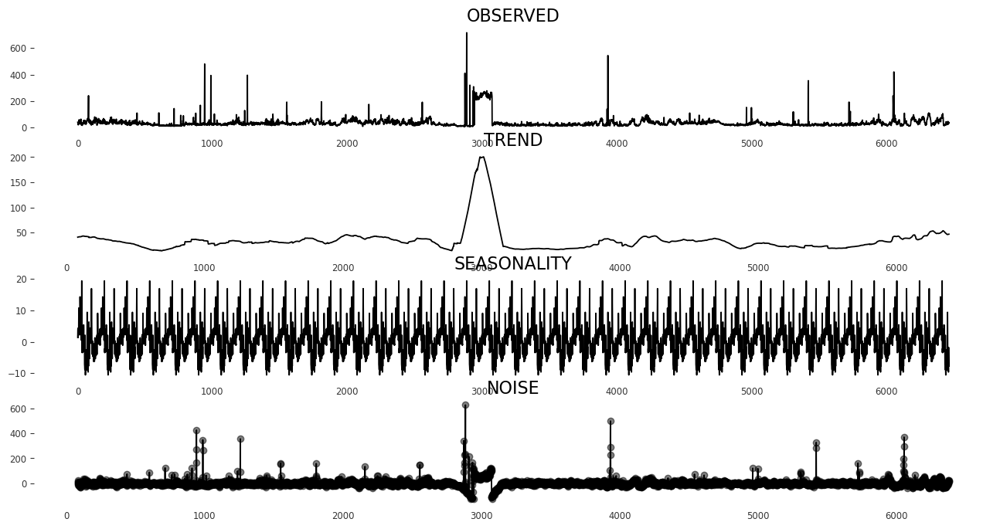



Mumbai


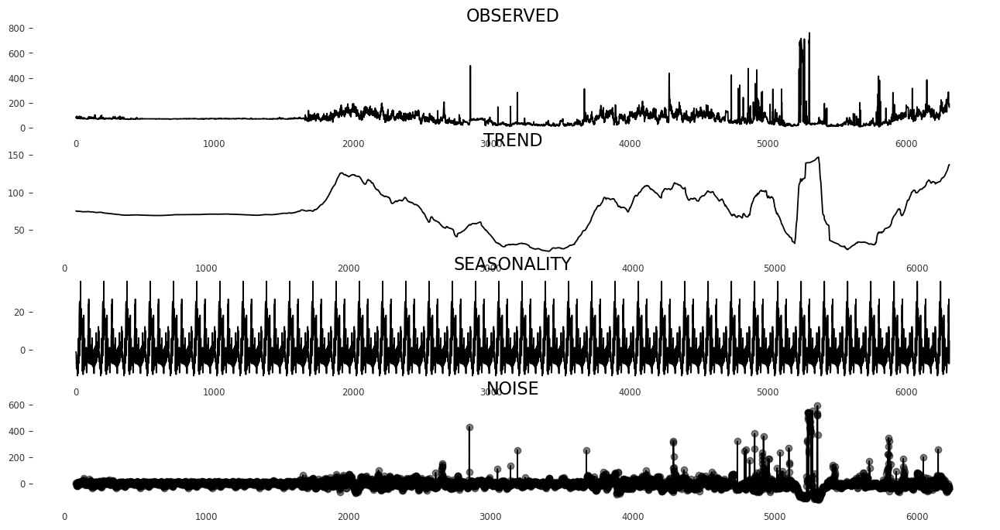

In [ ]:
# period = 7 weeks
for i in city_dic.keys():
    print(i)
    decompose_bike_sharing_demand(city_dic[i],share_type = "PM2.5",samples = "all",period = 168) #4 WEEKS
    print("\n")

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

In [ ]:
len(city_dic)

34

**ACF-PACF Plots**

/Users/yashkhandelwal/miniforge3/envs/torch-gpu/lib/python3.9/site-packages/statsmodels/graphics/tsaplots.py:348: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  warnings.warn(


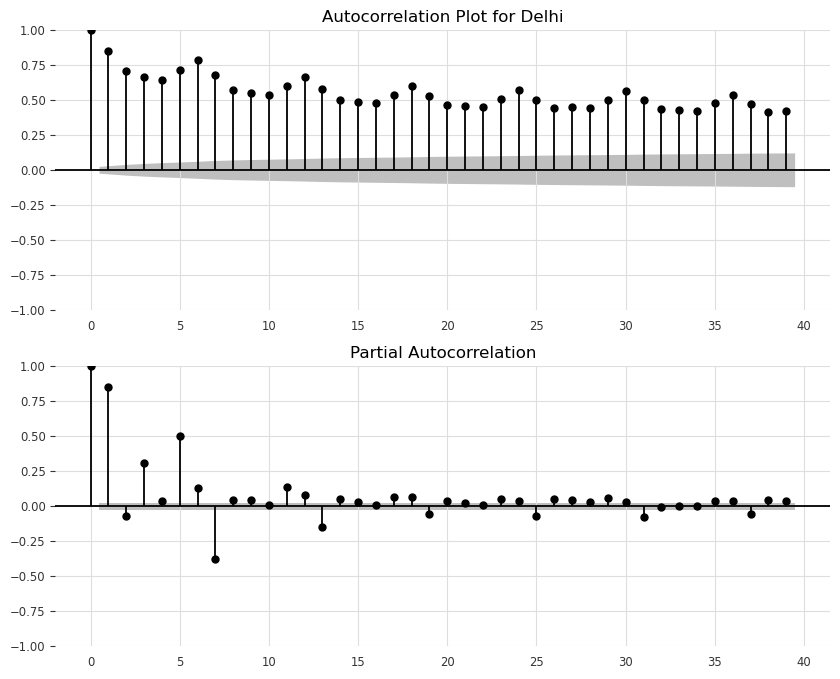

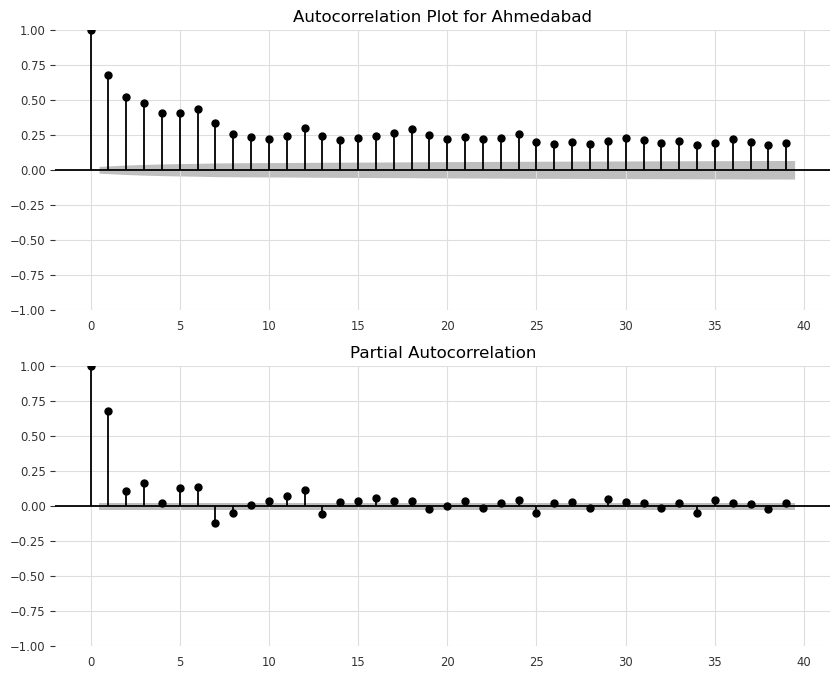

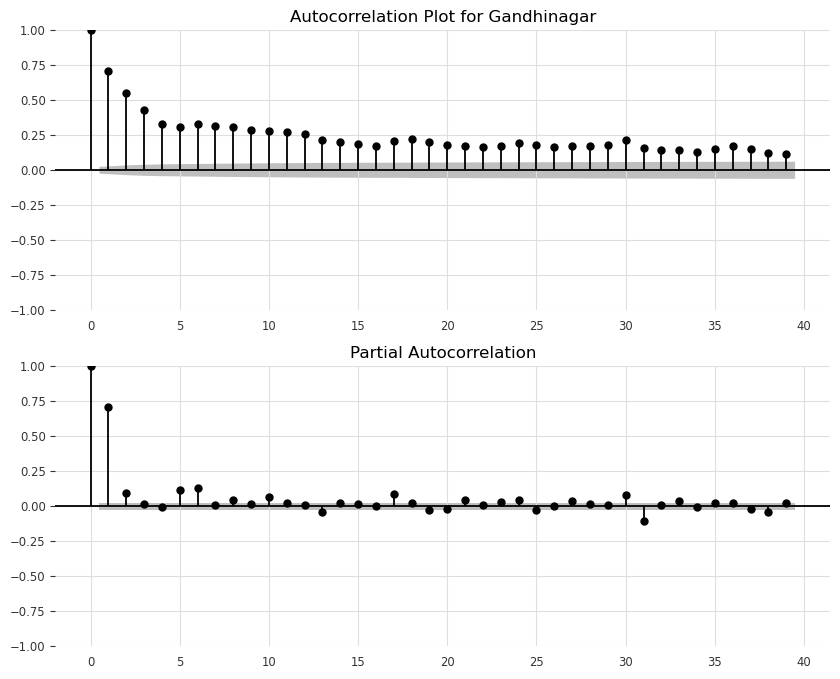

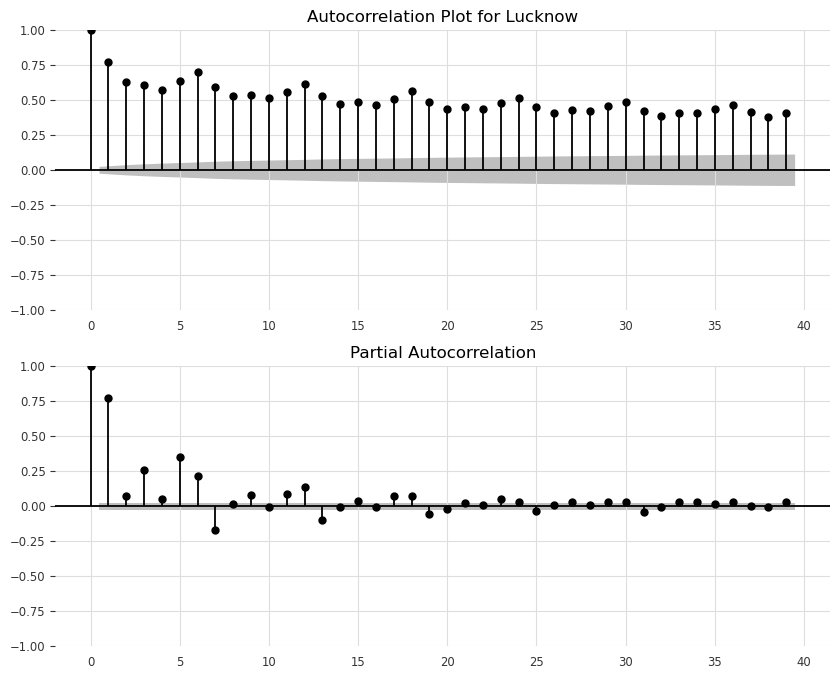

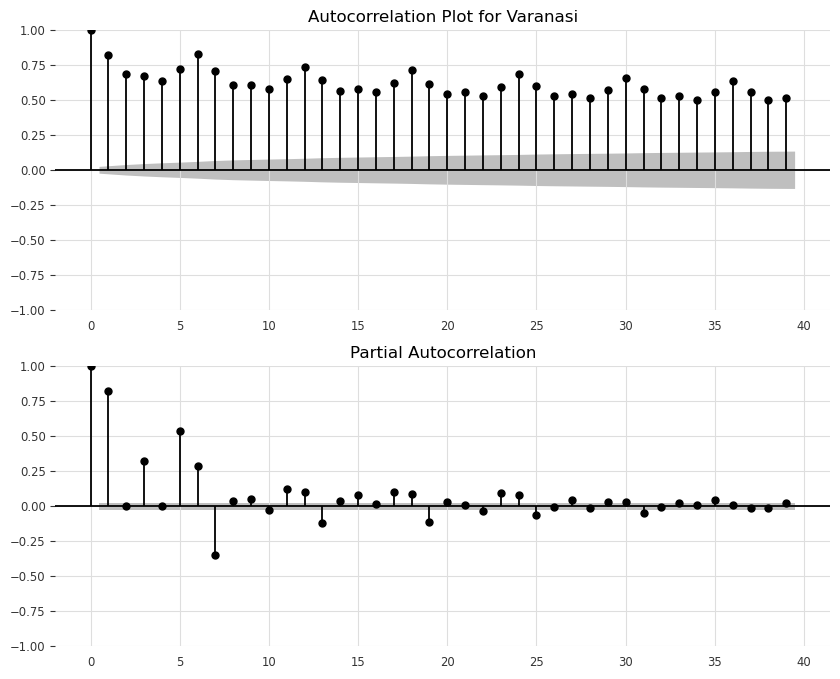

...

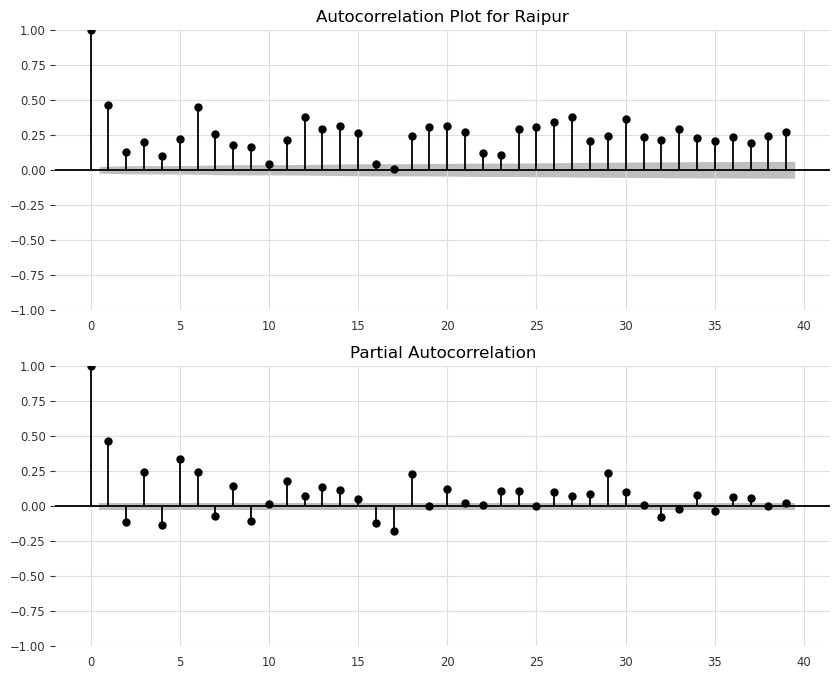

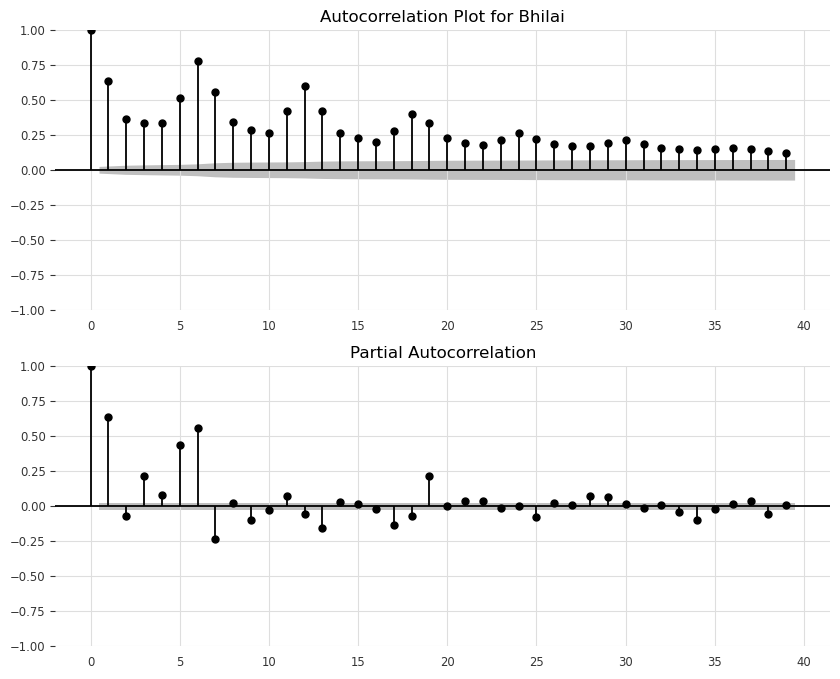

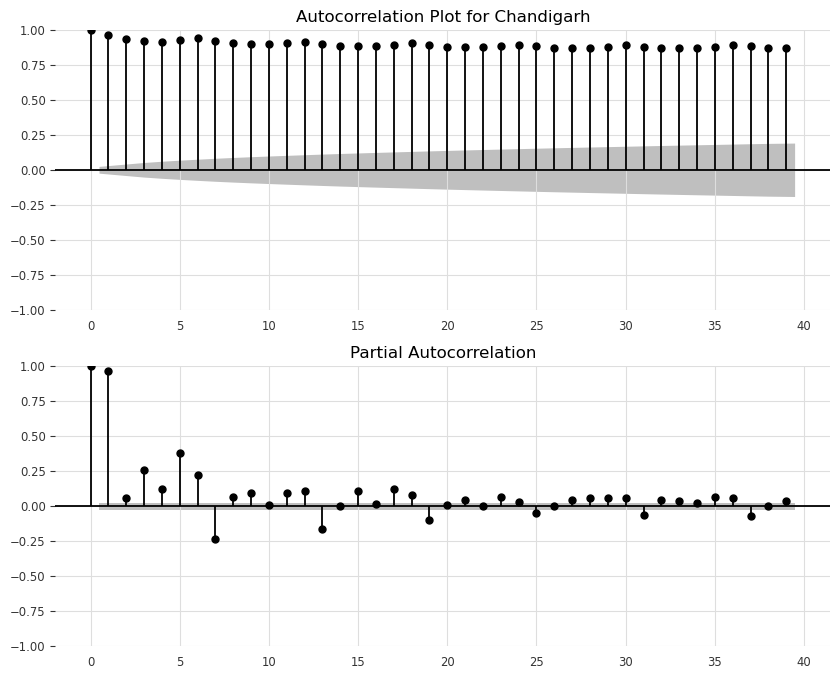

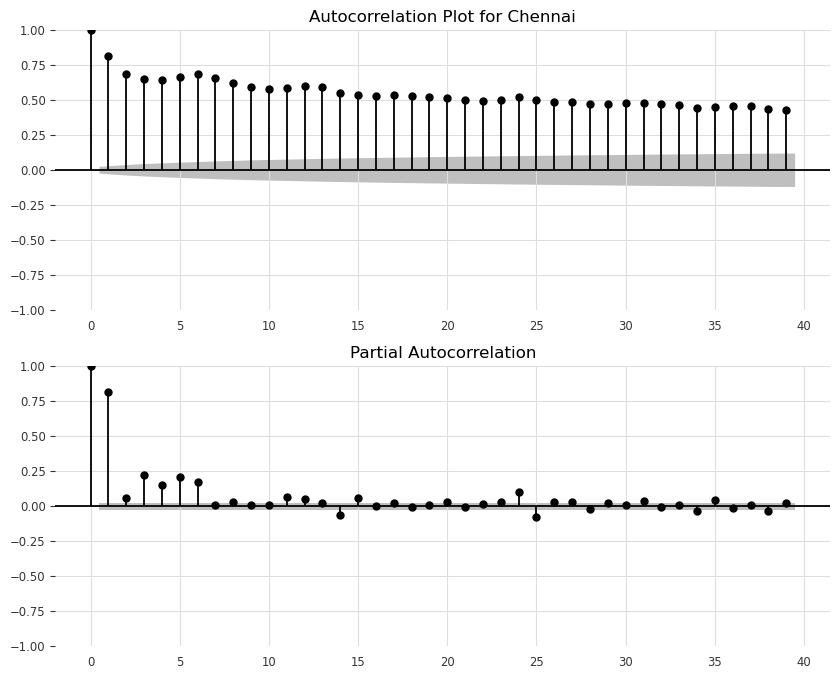

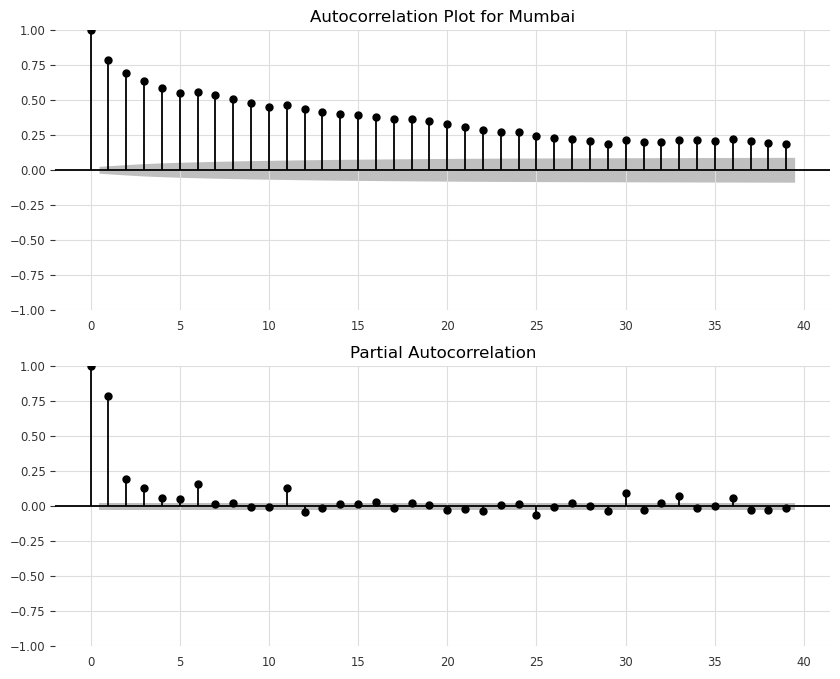

In [ ]:
for i in city_dic.keys():
    fig, axes = plt.subplots(2, 1, figsize=(10, 8))
    plot_acf(city_dic[i]['PM2.5'], ax=axes[0])
    plot_pacf(city_dic[i]['PM2.5'], ax=axes[1])
    axes[0].set_title(f'Autocorrelation Plot for {i}')
    plt.show()

We obtain a high auto-correlation with lag = 1.

There is a strong positive autocorrelation with lag 1: a high value now means that you are very likely to observe a high value in the next step. Since the autocorrelation shown here is partial, you do not see any duplicate effects with earlier lags, making the PACF plot neater and clearer.

None of the seasonal decomposition plots of the cities have a clear trend. While some of them have a clear seasonality. Hence smoothning techniques cannot be applied.

We need more forecasting advanced models.

- Granger’s Causality Test for correlation between multiple time series columns

- Perarson Correlation Coefficient

# Correlation Analysis

In [ ]:
corr_threshold = 0.5
target_col = "PM2.5"
selected = {}
for i in city_dic.keys():
    df = city_dic[i]
    corr_matrix = df.corr()[[target_col]]
    # filter out the target column and any attributes with a low correlation
    corr_matrix = corr_matrix[(corr_matrix[target_col].abs() > corr_threshold) & (corr_matrix.index != target_col)]
    high_corr_attributes = list(corr_matrix.index)
    selected[i] = high_corr_attributes

/var/folders/kq/3z96h0zn3qsb6f78g8l7fzqc0000gn/T/ipykernel_29653/2040387334.py:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()[[target_col]]
/var/folders/kq/3z96h0zn3qsb6f78g8l7fzqc0000gn/T/ipykernel_29653/2040387334.py:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()[[target_col]]
/var/folders/kq/3z96h0zn3qsb6f78g8l7fzqc0000gn/T/ipykernel_29653/2040387334.py:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr

/var/folders/kq/3z96h0zn3qsb6f78g8l7fzqc0000gn/T/ipykernel_29653/2040387334.py:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()[[target_col]]
/var/folders/kq/3z96h0zn3qsb6f78g8l7fzqc0000gn/T/ipykernel_29653/2040387334.py:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()[[target_col]]
/var/folders/kq/3z96h0zn3qsb6f78g8l7fzqc0000gn/T/ipykernel_29653/2040387334.py:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr

In [ ]:
selected.keys()

dict_keys(['Delhi', 'Ahmedabad', 'Gandhinagar', 'Lucknow', 'Varanasi', 'Meerut', 'Prayagraj', 'Ghaziabad', 'Agra', 'Noida', 'Kanpur', 'Moradabad', 'Guwahati', 'Faridabad', 'Gurugram', 'Jaipur', 'Kota', 'Imphal', 'Thiruvananthapuram', 'Agartala', 'Gaya', 'Muzaffarpur', 'Patna', 'Srinagar', 'Howrah', 'Kolkata', 'Bhopal', 'Gwalior', 'Bengaluru', 'Raipur', 'Bhilai', 'Chandigarh', 'Chennai', 'Mumbai'])

In [ ]:
#lets forecast those city pm2.5 that have no correlated attributes.

**Cities and their correlated variables to PM2.5 (THRESH = 0.5)**

In [ ]:
selected

{'Delhi': ['NO', 'NOx', 'NH3', 'CO', 'Benzene', 'Toluene', 'Temp', 'AT'],
 'Ahmedabad': [],
 'Gandhinagar': [],
 'Lucknow': ['NO', 'NO2', 'NOx', 'NH3'],
 'Varanasi': ['NO2', 'CO', 'Toluene', 'AT', 'Xylene'],
 'Meerut': ['AT'],
 'Prayagraj': ['NO', 'NO2', 'NOx', 'CO'],
 'Ghaziabad': ['NO', 'NO2', 'NOx', 'CO', 'Benzene', 'Toluene', 'AT'],
 'Agra': ['CO'],
 'Noida': ['NO2', 'NOx'],
 'Kanpur': ['NO2', 'NOx', 'CO'],
 'Moradabad': ['NH3',
  'CO',
  'Toluene',
  'RH',
  'WD',
  'BP',
  'AT',
  'O Xylene',
  'CNG ONLY',
  'DIESEL',
  'ELECTRIC(BOV)',
  'PETROL',
  'PETROL/CNG',
  'PETROL/HYBRID'],
 'Guwahati': ['NO', 'NOx', 'NH3', 'CO', 'Ozone', 'WS'],
 'Faridabad': ['CO'],
 'Gurugram': ['CO'],
 'Jaipur': ['NO2', 'NOx', 'Benzene'],
 'Kota': ['NOx', 'CO'],
 'Imphal': ['NO',
  'NO2',
  'NOx',
  'CO',
  'Benzene',
  'AT',
  'Eth-Benzene',
  'MP-Xylene'],
 'Thiruvananthapuram': [],
 'Agartala': ['NO2', 'NOx', 'CO'],
 'Gaya': [],
 'Muzaffarpur': ['AT'],
 'Patna': ['CO', 'AT'],
 'Srinagar': ['CO',
 

In [ ]:
#obtaining single sttributes cities
single = [i for i in selected if len(selected[i])==0]

**Cities with 0 correlated variables**

In [ ]:
single

['Ahmedabad',
 'Gandhinagar',
 'Thiruvananthapuram',
 'Gaya',
 'Bengaluru',
 'Raipur',
 'Chennai',
 'Mumbai']

In [ ]:
len(city_dic['Mumbai'])

6312

# Segmentation of Cities based on statistical Properties

In [ ]:
total_pm = sum([city_dic[i]['PM2.5'].sum() for i in city_dic.keys()])
total_pm

15091688.089644592

In [ ]:
#abc analysis
#self pm2.5/ aggregated pm2.5
city_segmented = {}
for i in city_dic.keys():
    sum_pm = city_dic[i]['PM2.5'].sum()
    ratio = sum_pm/total_pm
    city_segmented[i] = [ratio]

In [ ]:
city_segmented

{'Delhi': [0.05747265773566539],
 'Ahmedabad': [0.021890502805303424],
 'Gandhinagar': [0.024277295115984053],
 'Lucknow': [0.033832676588955536],
 'Varanasi': [0.019323634382996443],
 'Meerut': [0.0370735160071353],
 'Prayagraj': [0.018728985745652026],
 'Ghaziabad': [0.04058671889378589],
 'Agra': [0.023505618480658838],
 'Noida': [0.03942097996889647],
 'Kanpur': [0.024735694256124496],
 'Moradabad': [0.04569147669519149],
 'Guwahati': [0.038457479266637895],
 'Faridabad': [0.041029217528960965],
 'Gurugram': [0.03815774984655493],
 'Jaipur': [0.02190081353982836],
 'Kota': [0.023454535231408693],
 'Imphal': [0.01108709468485688],
 'Thiruvananthapuram': [0.01143723902670933],
 'Agartala': [0.02986865823548453],
 'Gaya': [0.044580156668862086],
 'Muzaffarpur': [0.033626772454495656],
 'Patna': [0.03385728979160633],
 'Srinagar': [0.022669338112994146],
 'Howrah': [0.025156383771099616],
 'Kolkata': [0.022646682446440115],
 'Bhopal': [0.017094806400101272],
 'Gwalior': [0.043756097729

In [ ]:
city_dic["Delhi"]['PM2.5'].std()

87.99776965837631

In [ ]:
for i in city_dic.keys():
    var = city_dic[i]['PM2.5'].std()
    city_segmented[i].append(var)

In [ ]:
city_segmented

{'Delhi': [0.05747265773566539, 87.99776965837631],
 'Ahmedabad': [0.021890502805303424, 33.57415376987825],
 'Gandhinagar': [0.024277295115984053, 26.776029665839424],
 'Lucknow': [0.033832676588955536, 64.53760384914818],
 'Varanasi': [0.019323634382996443, 31.95522674373987],
 'Meerut': [0.0370735160071353, 70.51814079073804],
 'Prayagraj': [0.018728985745652026, 31.851070064820156],
 'Ghaziabad': [0.04058671889378589, 91.99231002058802],
 'Agra': [0.023505618480658838, 43.27871330469006],
 'Noida': [0.03942097996889647, 83.01382157003162],
 'Kanpur': [0.024735694256124496, 44.85718511497559],
 'Moradabad': [0.04569147669519149, 38.47894166912655],
 'Guwahati': [0.038457479266637895, 28.117561302036922],
 'Faridabad': [0.041029217528960965, 76.91800547007739],
 'Gurugram': [0.03815774984655493, 77.01758500651061],
 'Jaipur': [0.02190081353982836, 35.42719443518281],
 'Kota': [0.023454535231408693, 37.848205892553814],
 'Imphal': [0.01108709468485688, 15.760766374978681],
 'Thiruvana

# ABC Analysis

In [ ]:
abc = [city_segmented[i][0] for i in city_segmented.keys() if city_segmented[i][0]]

In [ ]:
print(pd.Series(abc).quantile(0.80))
print(pd.Series(abc).quantile(0.50))

0.03988727553885224
0.024946039013612056


In [ ]:
a = [i for i in city_segmented.keys() if city_segmented[i][0] >= 0.03988727553885224] #The top 20% of time series by total value
b = [i for i in city_segmented.keys() if(city_segmented[i][0] <= 0.03988727553885224 and city_segmented[i][0] > 0.024946039013612056)]
c = [i for i in city_segmented.keys() if city_segmented[i][0]<=0.024946039013612056]

In [ ]:
a #high volume

['Delhi',
 'Ghaziabad',
 'Moradabad',
 'Faridabad',
 'Gaya',
 'Gwalior',
 'Chandigarh']

In [ ]:
b #moderate volume

['Lucknow',
 'Meerut',
 'Noida',
 'Guwahati',
 'Gurugram',
 'Agartala',
 'Muzaffarpur',
 'Patna',
 'Howrah',
 'Mumbai']

In [ ]:
c #low volume

['Ahmedabad',
 'Gandhinagar',
 'Varanasi',
 'Prayagraj',
 'Agra',
 'Kanpur',
 'Jaipur',
 'Kota',
 'Imphal',
 'Thiruvananthapuram',
 'Srinagar',
 'Kolkata',
 'Bhopal',
 'Bengaluru',
 'Raipur',
 'Bhilai',
 'Chennai']

# XYZ Analysis

In [ ]:
xyz = [city_dic[i]['PM2.5'].std() for i in city_dic.keys()]

In [ ]:
print(pd.Series(xyz).quantile(0.8))
print(pd.Series(xyz).quantile(0.5))

61.7292690207766
39.238562642582096


In [ ]:
z = [i for i in city_segmented.keys() if city_segmented[i][1] >= 61.7292690207766] #The top 20% of time series by total value
y = [i for i in city_segmented.keys() if(city_segmented[i][1] <= 61.7292690207766 and city_segmented[i][1] > 39.238562642582096)]
x = [i for i in city_segmented.keys() if city_segmented[i][1]<=39.238562642582096]

# ABC-XYZ

In [ ]:
import itertools

In [ ]:
ax = [i for i in city_segmented.keys() if(i in a and i in x)]
ax #high value, low variablity

['Moradabad', 'Gwalior']

In [ ]:
ax = [i for i in city_segmented.keys() if(i in a and i in x)] #high value, low variablity
bx = [i for i in city_segmented.keys() if(i in b and i in x)] #mid value, low variablity
cx = [i for i in city_segmented.keys() if(i in c and i in x)] #low value, low variablity
ay = [i for i in city_segmented.keys() if(i in a and i in y)] #high value, mid variablity
by = [i for i in city_segmented.keys() if(i in b and i in y)] #mid value, mid variablity
cy = [i for i in city_segmented.keys() if(i in c and i in y)] #low value, mid variablity
az = [i for i in city_segmented.keys() if(i in a and i in z)] #high value, high variablity
bz = [i for i in city_segmented.keys() if(i in b and i in z)] #mid value, high variablity
cz = [i for i in city_segmented.keys() if(i in c and i in z)] #low value, high variablity

In [ ]:
print(az)  #high value, high variablity

['Delhi', 'Ghaziabad', 'Faridabad']


In [ ]:
print(cx) #low value, low variablity

['Ahmedabad', 'Gandhinagar', 'Varanasi', 'Prayagraj', 'Jaipur', 'Kota', 'Imphal', 'Thiruvananthapuram', 'Srinagar', 'Bhopal', 'Bengaluru', 'Raipur', 'Bhilai']


In [ ]:
pd.Series(abc).describe()

count    34.000000
mean      0.029412
std       0.012335
min       0.011087
25%       0.021618
50%       0.024946
75%       0.038383
max       0.057919
dtype: float64

# Modelling

# ARIMA

Lets try univaraite forecasting on a stationary PM2.5 data (eg. Mumbai) with no correlated columns

In [ ]:
import math

In [ ]:
t = math.floor(len(city_dic['Mumbai']) * 0.8)
train = city_dic['Mumbai'][:t]
val = city_dic['Mumbai'][t:]

In [ ]:
model=ARIMA(city_dic['Mumbai']['PM2.5'],order=(1,0,1))

/Users/yashkhandelwal/miniforge3/envs/torch-gpu/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/Users/yashkhandelwal/miniforge3/envs/torch-gpu/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/Users/yashkhandelwal/miniforge3/envs/torch-gpu/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


In [ ]:
arima_model=model.fit()

In [ ]:
city_dic['Mumbai']['Forecast'] = arima_model.predict(start=t,end=6312,dynamic=True)

/Users/yashkhandelwal/miniforge3/envs/torch-gpu/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/var/folders/kq/3z96h0zn3qsb6f78g8l7fzqc0000gn/T/ipykernel_29653/1939720685.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_dic['Mumbai']['Forecast'] = arima_model.predict(start=t,end=6312,dynamic=True)


In [ ]:
pred = arima_model.predict(start=t,end=6312,dynamic=True)

/Users/yashkhandelwal/miniforge3/envs/torch-gpu/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


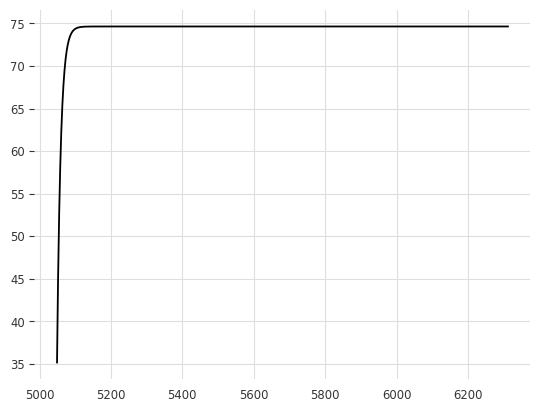

In [ ]:
plt.plot(pred)

**Poor prediciton results, the forecasted PM2.5 is almost constant throughout the test time period.**

# SARIMAX

In [ ]:
#lets try sarimax
from statsmodels.tsa.seasonal import seasonal_decompose
decomposition = seasonal_decompose(city_dic['Mumbai']['PM2.5'], model='additive', period=168)

# get the length of one cycle from the seasonal component
cycle_length = len(decomposition.seasonal[0:168])

In [ ]:
import statsmodels.api as sm

In [ ]:
t = math.floor(len( city_dic['Delhi']['PM2.5']) * 0.8)
t

5193

In [ ]:
train = city_dic['Delhi']['PM2.5'][:t]
test = city_dic['Delhi']['PM2.5'][t:]

In [ ]:
model=sm.tsa.statespace.SARIMAX(city_dic['Delhi']['PM2.5'],order=(1, 0, 1),seasonal_order=(1,0,1,12))

/Users/yashkhandelwal/miniforge3/envs/torch-gpu/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/Users/yashkhandelwal/miniforge3/envs/torch-gpu/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


In [ ]:
sarima_model=model.fit()

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.08282D+00    |proj g|=  8.64930D-02


 This problem is unconstrained.



At iterate    5    f=  5.05066D+00    |proj g|=  8.21445D-02

At iterate   10    f=  5.01454D+00    |proj g|=  1.14724D-02

At iterate   15    f=  4.97977D+00    |proj g|=  3.12781D-02

At iterate   20    f=  4.97570D+00    |proj g|=  3.91192D-03

At iterate   25    f=  4.97455D+00    |proj g|=  2.39439D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     27     35      1     0     0   9.589D-06   4.975D+00
  F =   4.9745481794453275     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


In [ ]:
pred = sarima_model.predict(start="2022-05-29 00:00:00",end="2022-12-31 20:00:00",dynamic=True)

In [ ]:
test

Time Periods
2022-05-29 00:00:00     83.745005
2022-05-29 04:00:00     88.091742
2022-05-29 08:00:00    107.371208
2022-05-29 12:00:00     87.551936
2022-05-29 16:00:00     86.649951
                          ...    
2022-12-31 04:00:00    196.175491
2022-12-31 08:00:00    116.911632
2022-12-31 12:00:00     90.348195
2022-12-31 16:00:00    128.424548
2022-12-31 20:00:00    163.290713
Name: PM2.5, Length: 1299, dtype: float64

In [ ]:
print(mean_absolute_error(test,pred))
print(mean_absolute_percentage_error(test,pred))
print(mean_squared_error(test,pred))

79.65300578959234
0.49563199359607724
16048.464828453818


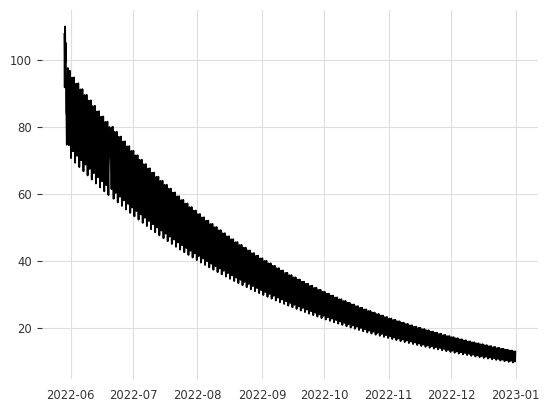

In [ ]:
plt.plot(pred)

In [ ]:
#lets use sarima on data with seasonality
#none of the single data have seasonality

In [ ]:
#lets create a training and validation data
start = 5049

p,d,q - d is the differencing that is not required, p - lag number that stands out in the acf plot, q - lag number that stands out in pacf plot

# Univariate Exponential Smoothening for CX type cities

In [ ]:
for i in cx:
    if i in stationary:
        print(i)

Ahmedabad
Gandhinagar
Varanasi
Prayagraj
Jaipur
Kota
Imphal
Thiruvananthapuram
Bhopal
Bengaluru
Bhilai


In [ ]:
city_dic['Ahmedabad'].drop(["City","State"],axis=1,inplace=True)

/var/folders/kq/3z96h0zn3qsb6f78g8l7fzqc0000gn/T/ipykernel_29653/454553465.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_dic['Ahmedabad'].drop(["City","State"],axis=1,inplace=True)


In [ ]:
az

['Delhi', 'Ghaziabad', 'Faridabad']

In [ ]:
train = city_dic['Ahmedabad'].iloc[:5187]
val = city_dic['Ahmedabad'].iloc[5187:]

In [ ]:
train1 = city_dic['Delhi'].iloc[:5260]
val1 = city_dic['Delhi'].iloc[5260:]

In [ ]:
t = train.to_numpy()

In [ ]:
len(val)

1297

In [ ]:
ses_model = SimpleExpSmoothing(train['PM2.5'].values).fit(smoothing_level=0.2)

y_pred = ses_model.forecast(1297)

mean_absolute_error(val['PM2.5'], y_pred)

37.766770286162405

In [ ]:
y_pred

array([70.7469235, 70.7469235, 70.7469235, ..., 70.7469235, 70.7469235,
       70.7469235])

In [ ]:
np.sqrt(mean_squared_error(val['PM2.5'], y_pred))

44.79583249564531

In [ ]:
c_d = city_dic.copy()

In [ ]:
tes_model = ES(train['PM2.5'].values,
                                 trend="add",
                                 seasonal="add",
                                 seasonal_periods=27).fit(smoothing_level=0.1,
                                                          smoothing_seasonal=0.1)
y_pred = tes_model.forecast(1297)
#plot_co2(train, test, y_pred, "Triple Exponential Smoothing")

In [ ]:
mean_absolute_percentage_error(val['PM2.5'], y_pred)

0.4537895452693367

In [ ]:
print(mean_absolute_error(val['PM2.5'], y_pred))
print(np.sqrt(mean_squared_error(val['PM2.5'], y_pred)))

19.02210622728022
34.66022512329297


Tripple Exponential Smoothening performing better

In [ ]:
#high for ax

In [ ]:
y_pred

array([67.23914301, 65.83745014, 67.47060147, ..., 15.84135755,
       21.80302809,  6.345714  ])

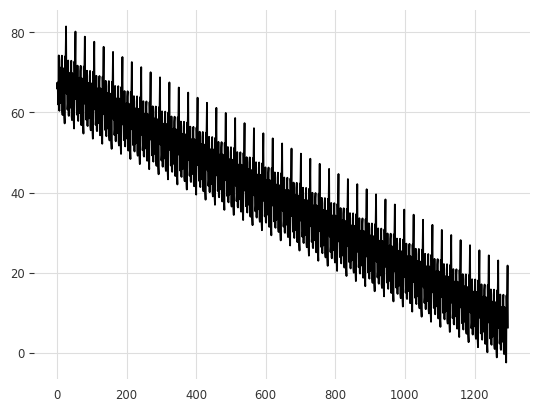

In [ ]:
plt.plot(y_pred)

In [ ]:
train['PM2.5'].describe()

count    5187.000000
mean       53.561947
std        33.194458
min        13.000788
25%        39.572024
50%        43.295701
75%        56.594120
max       551.963715
Name: PM2.5, dtype: float64

In [ ]:
#lets try this with

# Forecasting using Machine Learning

In [ ]:
def predict_ml(df,model):
        # Load the training data
    # cols = df.columns
    # df1 = df.append({'PM2.5':np.nan})
    if('City' in df.columns):
        df.drop(['City','State'],axis=1,inplace=True)
    y_test = df['PM2.5']
    ind = df.index[-1] + datetime.timedelta(hours=4)
    y_test.at[ind] = np.nan
    df = df.shift(1,freq='4H')
    # for i in cols:
    #     df[f"{i}_{step}"] = df[i].shift(1,freq='4H')
    #     if(i!='PM2.5'):
    #         df.drop(i,axis=1,inplace=True)

    train = df.iloc[:-1]
    test = df.iloc[-1]
    train.dropna(inplace=True)
    X_train = train.drop('PM2.5',axis=1)
    y_train = train['PM2.5']
    X_test = test.drop('PM2.5').to_numpy().reshape(1,-1)
#     y_test = test['PM2.5']
#     print(X_train,y_train)

    # Train the model
    model.fit(X_train,y_train)
    pred = model.predict(X_test)
    y_test.iloc[-1] = pred
    df['PM2.5'] = y_test
    return df,pred
    #Make predictions for the first 3 days of 2022


    # Print the predictions


In [ ]:
d.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 6316 entries, 2020-01-01 00:00:00 to 2022-12-31 20:00:00
Data columns (total 40 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   PM2.5                                             6316 non-null   float64
 1   NO                                                6316 non-null   float64
 2   NO2                                               6316 non-null   float64
 3   NOx                                               6316 non-null   float64
 4   NH3                                               6316 non-null   float64
 5   SO2                                               6316 non-null   float64
 6   CO                                                6316 non-null   float64
 7   Ozone                                             6316 non-null   float64
 8   Benzene                                           6316 non-nul

In [ ]:
def back_test(data,model):
    t = math.floor(len(data)*0.008)
    data.drop(['City','State'],axis=1,inplace=True)
    train = data[:t]
    test = data[t:]
    steps = len(test)

    pred = []
    for i in range(steps):
        train,res = predict_ml(train,model)
        pred.append(res)

#     print(mean_absolute_percentage_error(test['PM2.5'],pred))
#     print(mean_absolute_error(test['PM2.5'],pred))

    return mean_absolute_percentage_error(test['PM2.5'],pred),mean_absolute_error(test['PM2.5'],pred)

## Through the backtest, best predictions base on MAPE and MAE metric, we go with XGBoost

In [ ]:
#final pred
def final_pred(data,model):
    steps = 19
    for i in range(steps):
        data,res = predict_ml(data,model)

    return data

In [ ]:
ans = {}
for i in city_dic.keys():
    print(i)
    ans[i] = final_pred(city_dic[i],XGBRegressor())

Delhi
Ahmedabad
Gandhinagar
Lucknow
Varanasi
Meerut
Prayagraj
Ghaziabad
Agra
Noida
Kanpur
Moradabad
Guwahati
Faridabad
Gurugram
Jaipur
Kota
Imphal
Thiruvananthapuram
Agartala
Gaya
Muzaffarpur
Patna
Srinagar
Howrah
Kolkata
Bhopal
Gwalior
Bengaluru
Raipur
Bhilai
Chandigarh
Chennai
Mumbai


## Final dataframe

In [ ]:
q = pd.read_excel("Round1a_Submission_Template.xlsx")

In [ ]:
for j,i in enumerate(q['City'].unique()):
    print(i,j)
    if(j==0):
        data = ans[i][-19:-1]
    else:
        sub = ans[i][-19:-1]
        data = pd.concat([data,sub],axis=0)

Delhi 0
Ahmedabad 1
Gandhinagar 2
Lucknow 3
Varanasi 4
Meerut 5
Prayagraj 6
Ghaziabad 7
Agra 8
Noida 9
Kanpur 10
Moradabad 11
Guwahati 12
Faridabad 13
Gurugram 14
Jaipur 15
Kota 16
Imphal 17
Thiruvananthapuram 18
Agartala 19
Gaya 20
Muzaffarpur 21
Patna 22
Srinagar 23
Howrah 24
Kolkata 25
Bhopal 26
Gwalior 27
Bengaluru 28
Chandigarh 29
Chennai 30
Mumbai 31
Raipur 32
Bhilai 33


In [ ]:
w

['Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Delhi',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Ahmedabad',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Gandhinagar',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Lucknow',
 'Varanasi',
 'Varanasi',
 'Varanasi',
 'Varanasi',
 'Varanasi',

In [ ]:
pd.Series(w)

0       Delhi
1       Delhi
2       Delhi
3       Delhi
4       Delhi
        ...  
607    Bhilai
608    Bhilai
609    Bhilai
610    Bhilai
611    Bhilai
Length: 612, dtype: object

In [ ]:
w = []
for i in q['City'].unique():
    l = [i for k in range(0,18)]
    w = w + l

In [ ]:
data['City'] = w

In [ ]:
data['Time_Periods'] = data.index

In [ ]:
data = data.rename(columns = {"PM2.5":"PM2.5_Prediction"})

In [ ]:
data['PM2.5_Prediction'] = data['PM2.5_Prediction'].interpolate(method = "time")

In [ ]:
submission = data[['City','Time_Periods','PM2.5_Prediction']]
submission

,City,Time_Periods,PM2.5_Prediction
Time Periods,,,
2023-01-01 00:00:00,Delhi,2023-01-01 00:00:00,265.170319
2023-01-01 04:00:00,Delhi,2023-01-01 04:00:00,190.687500
2023-01-01 08:00:00,Delhi,2023-01-01 08:00:00,173.824142
2023-01-01 12:00:00,Delhi,2023-01-01 12:00:00,201.083939
2023-01-01 16:00:00,Delhi,2023-01-01 16:00:00,184.262848
...,...,...,...
2023-01-03 04:00:00,Bhilai,2023-01-03 04:00:00,34.236515
2023-01-03 08:00:00,Bhilai,2023-01-03 08:00:00,34.349014
2023-01-03 12:00:00,Bhilai,2023-01-03 12:00:00,34.109173


In [ ]:
submission.reset_index(inplace=True,drop=True)

In [ ]:
submission['ID'] = submission.index

In [ ]:
submission['PM2.5_Prediction'] = submission['PM2.5_Prediction'].round(2)
submission

,City,Time_Periods,PM2.5_Prediction,ID
0,Delhi,2023-01-01 00:00:00,265.17,0
1,Delhi,2023-01-01 04:00:00,190.69,1
2,Delhi,2023-01-01 08:00:00,173.82,2
3,Delhi,2023-01-01 12:00:00,201.08,3
4,Delhi,2023-01-01 16:00:00,184.26,4
...,...,...,...,...
607,Bhilai,2023-01-03 04:00:00,34.24,607
608,Bhilai,2023-01-03 08:00:00,34.35,608
609,Bhilai,2023-01-03 12:00:00,34.11,609
610,Bhilai,2023-01-03 16:00:00,34.16,610


In [ ]:
submission.to_excel("imh10085.19@bitmesra.ac.in_ST_R1.xlsx",index=False)

In [ ]:
# for j,i in enumerate(city_dic.keys()):
#     print(i)
#     sub = pd.DataFrame()
#     sub['City'] = ""
#     sub['Time Periods'] = np.nan
#     sub['PM2.5_Prediction'] = np.nan
#     print(sub)
#     for k in range(18):
#         sub['City'].iloc[k] = i
#         sub['Time Periods'].iloc[k] = ans[i].index[-19+k]
#         sub['PM2.5_Prediction'].iloc[k] = ans[i]['PM2.5'][-19+k]
#         if(j==1):
#             data = sub
#         else:
#             data = pd.concat([data,sub],axis=0)

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# t = math.floor(len(data)*0.01)
# #data.drop(['City','State'],axis=1,inplace=True)
# train = data[:t]
# test = data[t:]
# steps = len(test)

# pred = []
# for i in range(steps):
#     train,res = predict_ml(train,model)
#     pred.append(res)

# print(mean_absolute_percentage_error(test['PM2.5'],pred))
# print(mean_absolute_error(test['PM2.5'],pred))

In [ ]:
#     # Load the training data
# df.drop(['City','State'],axis=1,inplace=True)
# cols = df.columns
# for i in cols:
#     df[f"{i}_{step}"] = df[i].shift(1)
#     if(i!='PM2.5'):
#         df.drop(i,axis=1,inplace=True)

# train = df.iloc[:-1]
# test = df.iloc[-1]
# print(test)
# train.dropna(inplace=True)
# X_train = train.drop('PM2.5',axis=1)
# y_train = train['PM2.5']
# X_test = test.drop('PM2.5')
# #     y_test = test['PM2.5']
# #     print(X_train,y_train)

# # Train the model
# model.fit(X_train,y_train)
# pred = model.predict(X_test)
# df['PM2.5'].iloc[-1] = pred
# return df,pred